# Project 2 report - Group 80 

### A Regression Analysis to Determine the Impact of Weather and Congestion Charge on Pollutant Levels in London between 2018 and 2021

Authors: Jonathan Hoover, Yihang Liu, Yiming Ma, Jack Studman

### **Package Installation**

We have provided an environment file (environment.yaml) to load the environment we used; however, there were some issues on some computers within our group loading this environment file. We have also provided a backup (environment_backup.yaml) in a folder called /environment_backup.

If neither of these work, the instructions for manually loading the packages through conda and pip are included here (Approved by Professor Amini Kafiabad):

anaconda packages <br>
conda install geopandas <br>
conda install -c conda-forge descartes <br>
conda install -c conda-forge statsmodels <br>

pip packages<br>
pip install py-openaq<br>
pip install bng_latlon<br>
pip install meteostat<br>

In [2]:
## General packages

import pandas as pd
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import openaq
import datetime
import warnings

## Import packages required for polygon usage (these are also installed in the environment file)
## Including here because they are specific to the polygon geographies

import geopandas
import fiona
import descartes
import bng_latlon as bng
from shapely.geometry import Polygon, LineString, Point ## https://geopandas.org/en/stable/docs/reference/api/geopandas.GeoSeries.contains.html
from shapely.ops import cascaded_union ## https://stackoverflow.com/questions/40385782/make-a-union-of-polygons-in-geopandas-or-shapely-into-a-single-geometry

## Packages for weather

from meteostat import Stations, Daily ##this required a pip install, but it is included in the environment

## Package for regression

import statsmodels.api as sm # https://www.statsmodels.org/dev/gettingstarted.html
from patsy import dmatrices

warnings.simplefilter('ignore')
%matplotlib inline

# Set major seaborn asthetics

sns.set("notebook", style='ticks', font_scale=1.0)

# Increase the quality of inline plots

mpl.rcParams['figure.dpi']= 500

print ("pandas v{}".format(pd.__version__))
print ("matplotlib v{}".format(mpl.__version__))
print ("seaborn v{}".format(sns.__version__))
print ("openaq v{}".format(openaq.__version__))
print ("geopandas v{}".format(geopandas.__version__))
print ("statsmodels v{}".format(sm.__version__))

pandas v1.1.3
matplotlib v3.3.1
seaborn v0.11.0
openaq v1.1.0
geopandas v0.6.1
statsmodels v0.13.1


### **Introduction**

We will be analyzing the role of weather (wind speed, average temperature, and precipitation) and the Congestion Charge Zone (CCZ; city policy) on pollutant levels (pm10: respirable particulate matter, pm25: fine particulate matter, o3: ozone, NOx：generic term for the nitrogen oxides) in London from 2018-2021.

Our hypotheses are: <br>
**1)** Pollutant levels will decrease with increases in windspeed, precipitation and implementation of the congestion charge zone (rain and wind should disperse the pollutants and the CCZ should lower emissions) <br>

**2)** Pollutant levels will increase with increases in temperature (maybe higher pollutant levels could cause higher temperatures)

The first step of this analysis is to gather and merge the datasets to produce a final dataset to perform a regression on.

The data sources are:
1) Weather: meteostat.net <br>
2) Air Quality: openaq.org <br>
3) Geographic Information for London Boroughs:  Greater London Authority (https://data.london.gov.uk/dataset/statistical-gis-boundary-files-london) (Accessed 24 Nov 2021) <br>
4) Emissions Data for London Boroughs: Greater London Authority (https://data.london.gov.uk/dataset/london-atmospheric-emissions-inventory--laei--2016) (Accessed 18 Nov 2021) <br>

Both meteostat and openaq have associated python packages that can make api calls for the data of interest.
These packages have been installed through anaconda, and are included in the environment file.

We are seeking data for each month from January 1, 2018 through December 2021. For weather data, the website's servers can handle a large api request; however, for the aqi data, we need to break up the calls month by month to ensure we get data for each month (we attempted larger requests, but the calls only yielded December 2021 data). For aqi data, we will request data from all sensors within a 32 km radius of the center of London (this radius covers London and Greater London). For weather data, we will request sensors within a 32 km radius and choose the sensor that provides the largest date range of data with the most complete dataset (we use one sensor under the assumption that weather across the area of study will be fairly consistent at any given time).

The code to gather this data is included below.

**NOTE: Given these data aquisition and modification steps take a long time, we have provided a final summary dataframe at the end if you don't wish to run all of these steps. We have also provided intermediate csv's with api request data.**


### Justifications for Analysis

As a background to our study, data was first gathered from Greater London Authority for the abovementioned pollutants created by vehicles for the years 2010, 2013 and 2016 to identify any visible patterns. Using this data, heat maps were plotted. Such plots are useful not only as they highlight key transport routes within Central and Greater London, but also provide insight into emissions hot spots.

In [3]:
# Create dataframe from Vehicle Emissions CSV File 

df = pd.read_csv('./Datasets/vehicle_emissions.csv')

# Define parameters for Car - Petrol emissions for each year

cp_2010 = df[(df['Year'] == 2010) & (df['Source'] == 'Car - Petrol')]
cp_2013 = df[(df['Year'] == 2013) & (df['Source'] == 'Car - Petrol')]
cp_2016 = df[(df['Year'] == 2016) & (df['Source'] == 'Car - Petrol')]


# Plotting Heat Maps 

sns.set_theme()

# Define sets of PM10 emissions for each year and each set of coordinates 

PM10_2010 = cp_2010.pivot_table("PM10_Emissions_tpa", "Northing", "Easting" )
PM10_2013 = cp_2013.pivot_table("PM10_Emissions_tpa", "Northing", "Easting" )
PM10_2016 = cp_2016.pivot_table("PM10_Emissions_tpa", "Northing", "Easting" )


fig, (ax_2010, ax_2013, ax_2016) = plt.subplots(3, 1, figsize=(12, 24))

# For each year, a heat map through colour range red to yellow to green shall be plotted
# Red shall represent high emission zones, green represents low emission zones
# The maximum value for each map shall be 2 to ensure comparability between the plots

ax_2010 = (sns.heatmap(PM10_2010, cmap="RdYlGn_r", linewidths=0, ax=ax_2010, vmin = 0, vmax = 2))
ax_2010.set_title('Cars - Petrol PM10 Emissions 2010 (Tons Per Annum)', fontsize = 20)

ax_2013 = (sns.heatmap(PM10_2013, cmap="RdYlGn_r", linewidths=0, ax=ax_2013, vmin = 0, vmax = 2))
ax_2013.set_title('Cars - Petrol PM10 Emissions 2013 (Tons Per Annum)', fontsize = 20)

ax_2016 = (sns.heatmap(PM10_2016, cmap="RdYlGn_r", linewidths=0, ax=ax_2016, vmin = 0, vmax = 2))
ax_2016.set_title('Cars - Petrol PM10 Emissions 2016 (Tons Per Annum)', fontsize = 20)

# Y axis is inverted to correctly map orientation of London

ax_2010.invert_yaxis()
ax_2013.invert_yaxis()
ax_2016.invert_yaxis()

fig.tight_layout()

### Heat Map Discussion 

The above heat map examples were created using PM10 emissions data from petrol cars. Analysing the plots, most emissions can be seen to occur centrally, with values typically falling to near 0 before rising again at the transport route encicling the area of study. It can be seen that whilst there are clear reductions in PM10 emissions across the region from 2010 to 2016, pollution hot spots near the center of the plot can still be identified. Given that policies such as Congestion Charge are in effect in central London, this raises the question of whether it is having a measurable impact in decreasing pollution. 

Furthermore, examining the outer rim of the plots it is clear there has been a sizable reduction in emissions along this transport route, raising the question of whether levels of pollution are falling faster within Central London, where policies are in place, or outwith Central London, where Congestion Charge is not in place. 

### **Analysis**

**AQI data aquisition (via API request from openaq.org)**

In [5]:
## Lines 16-17: MEA
## URL: https://stackoverflow.com/questions/22696662/python-list-of-first-day-of-month-for-given-period
## Accessed 24 Nov 2021

## Lines 16-17: Pandas Documentation
## URL: https://pandas.pydata.org/docs/user_guide/timeseries.html#timeseries-offset-aliases
## Accessed 24 Nov 2021


## AQI data aquisition

## Step 1: Define date ranges for each api request
## We will perform a request for each month from January 2018 until December 2021
## So we need to get start and end dates for each month in that range

first_dates = list(pd.date_range('2018-01-01','2021-12-31' , freq='MS').strftime("%Y-%m-%d")) ## freq="MS" gives month starts; converts back to string
last_dates = list(pd.date_range('2018-01-01','2021-12-31' , freq='M').strftime("%Y-%m-%d") ) ## freq="M" gives month ends; converts back to string


## Step 2: Run a loop over the first and last dates to perform the api-request for a 32 km radius around London for each month
## Add each of these to a dataframe and concatenate at the end. We will save this as a CSV to prevent multiple calls

api = openaq.OpenAQ(version="v2") ## Need v2 so the request works properly, otherwise a bad request error is returned 

## Initialize dataframe
res = pd.DataFrame()

london_center = "51.5072,-0.1276" ## Coordinates for center of London
radius = 32000 ## Radius to search around central coordinates (in meters)

for first, last in zip(first_dates, last_dates): ## This format lets us iterate through both first and last dates simultaneously
    res1 = api.measurements(coordinates=london_center, ## Center of London
                            date_from = first,
                            date_to = last,
                            unit = "µg/m³", ## Requested units to report (copied from openaqi tutorial)
                            radius=radius,limit=1000, ## 32km outside of center of london
                            df=True)
    res = pd.concat([res, res1]) ## Add latest iteration data to the summary dataframe

#pd.DataFrame.to_csv(res, path_or_buf = "./Datasets/SensorData_London2.csv", header = True)

**Weather data aquisition (via API request from meteostat.net)**

In [6]:
## Lines 9 and 15-21: Meteostat Documentation 
## URL: https://dev.meteostat.net/python/stations.html#example
## Accessed on 25 Nov 2021


## Weather Data Aquisition (from meteostat)
## Stations are searched by location near a point


## Step 1: Identify weather sensors within a 32 Km radius of the center of london

london_lat = 51.5072 ## Northing coordinate
london_lon = -0.1276 ## Easting coordinate

stations = Stations() ## Get all stations available
stations = stations.nearby(lat = london_lat, ## center of London latitude
                           lon = london_lon, ## center of London longitude
                           radius = 32000 ## radius (32km) around london; used for aqi data
                          )## get stations within 32km radius of center of london

stations = stations.fetch() ## Return list of stations in 32 km radius around center of London

 
## Pulling weather data from London Heathrow Airport station because it has full data from Jan 1, 2018 to Dec 2021
## Only selecting one dataset because weather should be consistent throughout London

start = datetime.datetime(2018, 1, 1) ## Starting Jan 1, 2018
end = datetime.datetime(2021, 12, 31) ## Ending Dec 32, 2021

## Pull LHR Data from start date to end date

weather_daily = Daily(loc = stations.loc[stations["name"] == "London Heathrow Airport"], start = start, end = end) 
weather_daily = weather_daily.fetch() ## Fetches individual data for all dates

## Modify format of the data frame to add a "date" column that we can use to merge with api data

weather_daily[["date"]] = weather_daily.index.values ## adds date column using index values (which are data)
weather_daily["date"] = weather_daily["date"].dt.strftime("%Y-%m-%d") ## convert to string for merging

# pd.DataFrame.to_csv(weather_daily, path_or_buf = "./Datasets/weather_daily.csv", header = True)

The next step is to modify both datasets to fit the format we want for analysis and then merge.

For the AQI data, there are some negative values for the parameters (pollutants) we pulled, which don't make scientific sense, 
so these values will be excluded. Additionally, there are some zero values. Given we will perform a log-transformation on some of the pollutant values to allow us to do a linear regression that meets the assumptions of normality and constant variance, we cannot have zero values (log(0) = -inf), as such, we modify these zero values to be very small values (ie 0.01 $ug/m^3$) which should not change the analysis, but enables us to actually perform a regression.

Given the true concentration is likely not a true zero value and just below the limit of detection, this assumption is a valid assumption

The code for this is included below.

**NOTE: In addition to the final summary csv, we have also provided intermediary csv's with the api request data if you don't wish to run the whole thing**

In [7]:
# The following can be uncommented if you don't want to run the api requests, or if they are not working

# res = pd.read_csv("./Datasets/SensorData_London2.csv", header = 0)
# weather_daily = pd.read_csv("./Datasets/weather_daily.csv", header = 0)

In [8]:
##Turn date into Y-m-d format from timestamp. First go to string, then datetime, then get Y-m-d, and go back to string

res["date"] = res["date.utc"].apply(lambda x: str(x)) ## Format as string first so we can convert directly to datetime from timestamp
res["date"] = res["date"].str.split("+").str[0] ## Gets rid of excess digits
res["date"] = res["date"].apply(lambda x: datetime.datetime.strptime(x, "%Y-%m-%d %H:%M:%S")) ## Format as datetime
res["month_year"] = res["date"].dt.to_period("M").dt.strftime("%Y-%m") ## Get data as month_year for one portion of analysis that averages over month
res["date"] = res["date"].dt.to_period("D").dt.strftime("%Y-%m-%d") ## Drop hour info; convert back to string for merging


## Get log values of parameters to solve for non-linearity and normality during regression
## Also exclude negative parameter data because a negative measurement for a pollutant doesn't make sense
## Some values are zero, so log-values will yield -inf; therefore adding small value to zero (1e-8)

res = res.loc[res["value"] >= 0] ## Excludes non-sensical negative data (small number of observations)
res.loc[res["value"] == 0, "value"] = 1e-1 ## Makes zero values small so we can handle in log function
res['log_params'] = res["value"].apply(lambda x: np.log(x)) ## Apply log function to all values in the column

## Reformat the units from double encoded utf (unintelligible) to intended units: ug/m^3 (\u00b3)

res["unit"] =  "ug/m\u00b3" ## Changes unit to correct format

## Add weather data to pollution data with a left merge

aqi_weather = res.merge(weather_daily, how = "left", on = "date")

**Geographical Data Acquisition** <br>

The next step is to add geographical information to our dataset so we can distinguish between pollutants within areas of london that have implemented "green policies" to reduce emissions and areas that have not. The area of interest is the Congestion Charge Zone (CCZ)/ The CCZ was implemented in 2003, so it is active throughout all the times we have looked at.

CCZ zones are defined within the "Central" burroughs of London via the CSV London_Emissions included within our repository. This data was accessed and downloaded from Greater London Authority (please see Introdution for URL). 

We then found a shape file through the London Greater Authority that defined each borough, and used these boroughs to define the "Central" zone, which is a proxy for the CCZ. We then greated our own shape file or polygon for the central zone and tested whether the aqi censors were present within the zone.

Note that the polygons (shape files) define the coordinates in the British National Grid system (BNG) while openaq gives coordinates via latitidue and longitude, so we needed to convert latitude longitude data to the BNG format to test if a given sensor was present in either the ULEZ or CCZ. There is a package called BNG_latlon that performs this conversion for us. We defined wrapper functions to do the conversion to BNG and then test if a coordinate is present in a polygon (region).

All code is present below.

**Note: Given this takes a long time, we have also provided the CSV of the merged data as well as the merged polygon if you don't wish to run this whole thing (present in the next code cell after this)**

In [9]:
## Convert df of coordinates to bng

def DF_LatLongtoBNG(coordinates_df):
    """
    Goal: Convert Latitude Longitude coordinates from a coordinate dataframe to BNG Coordinates
    
    Inputs: 
    BNG_coordinates: Pandas DataFrame with 2 Columns (Col 1 = Northing, Col 2 = Easting) that contains
                     the Latitude/Longitude coordinates of a point 
    
    Output:
    Dataframe with "Coord" column for BNG coordinates (in tuple format)
    """
    
    ## Apply the bng to latitude longitude function from bng_latlon package to each row in the supplied coordinate 
    ## dataframe and return as a dataframe with the column name "Coords"
    
    BNG = pd.DataFrame(coordinates_df.apply(lambda df: bng.WGS84toOSGB36(df[0], df[1]), axis=1))
    BNG.columns = ["Coords"] ## Rename column
    return(BNG)

## Test if coordinates are in a polygon

def coordsInPolygon(coordinates, polygon):
    """
    Goal: Convert Latitude Longitude coordinates from a coordinate dataframe to BNG Coordinates and 
          Test if each coordinate in that DataFrame of BNG coordinates is present in a polygon
    
    Inputs:
    BNG_coordinates: Pandas DataFrame with 2 Columns (Col 1 = Northing, Col 2 = Easting) that contains
                     the Latitude/Longitude coordinates of a point 
    polygon: A polygon (in BNG coordinate format) that we want to test
    
    Output:
    Dataframe with two columns 
    Col 1: BNG coordinates (in tuple format)
    Col 2: Boolean indicating whether that point is contained within the Polygon
    """
    ## Convert coordinate dataframe to BNG Coordinates
    
    BNG_coordinates = DF_LatLongtoBNG(coordinates)
    
    ## Create boolean list for each point saying if it is present in the polygon
    
    ## Testing to see if each coordinate is within the polygon of interest
    ## For each point, uses polygon.contains(Point) from shapely to see if the point is present
    ## the [0] at the end of shape.contains(...)[0] returns just the T/F value
    
    InPolygon = [polygon.contains(Point(BNG_coordinates.iloc[i]))[0] for i in range(len(BNG_coordinates))]
    
    ## Add the boolean data to the BNG dataframe
    
    BNG_coordinates["In_Polygon"] = InPolygon
    return(BNG_coordinates)

#########################################################################################################################

## Part 1: Load and define polygons/regions we need

## Load in London boroughs shape file
## Need ALL files associated with london_Ward.shp present in ./Datasets/ folder for this to work

london = geopandas.read_file("Datasets/London_Borough_Excluding_MHW.shp")

## Taking Zone = Central as our definition for whether the borough is a CCZ from London_Emissions CSV, we
## define Central Zone boroughs based on dataset: 

central_zones = ["Westminster", "Camden", "City of London", "Southwark", "Lambeth", "Islington", "Hackney", "Tower Hamlets"]
london["Zone"] = np.where(london['NAME'].isin(central_zones), 1, 0)


## Create central_zone polygon we want to test

central_polygon = geopandas.GeoSeries(cascaded_union(london[london["Zone"] == 1]["geometry"])) ##merges all shapes for boroughs in london

## Load ULEZ polygon we want to test

ULEZ_gdf = geopandas.read_file("Datasets/ULEZ.gpkg")


## Part 2: Test if coordinates of sensors are present in each polygon and add to dataset

## Check if in central zone and add to dataset
aqi_weather[["coords_BNG", "In_Central"]] = coordsInPolygon(aqi_weather[["coordinates.latitude", "coordinates.longitude"]], central_polygon)

# pd.DataFrame.to_csv(aqi_weather, path_or_buf = "./Datasets/aqi_weather.csv", header = True)

**The following reads in the fully modified dataset to use if you do not wish to run the above code)**

In [10]:
# The following can be uncommented if you don't run the Geographic zone search (or any of the previous cod)
# aqi_weather = pd.read_csv("./Datasets/aqi_weather.csv", header = 0)


**The following will read in the central shape file and check if the coordinates are present if you want to test the code, but don't want to merge the central polygon**

In [11]:
# central_polygon = geopandas.read_file("Datasets/central_london.shp")

# Check if in central zone and add to dataset
# aqi_weather[["coords_BNG", "In_Central"]] = coordsInPolygon(aqi_weather[["coordinates.latitude", "coordinates.longitude"]], central_polygon)

**Data Exploration**

The next step is to plot the pollutant values against each of the prediction variables (average temperature, windspeed, and precipitation). We will also plot the log_values against the predictor variables to explore the dataset and see which values
need to be modelled as log values and which can be modelled as normal values.

Following this, we will determine if any of the parameters are not suitable for a linear model.

**Note: We have chosen to plot the plots individually (not in subplots) because they are too hard to visualize if they are compacted any more than they currently are**

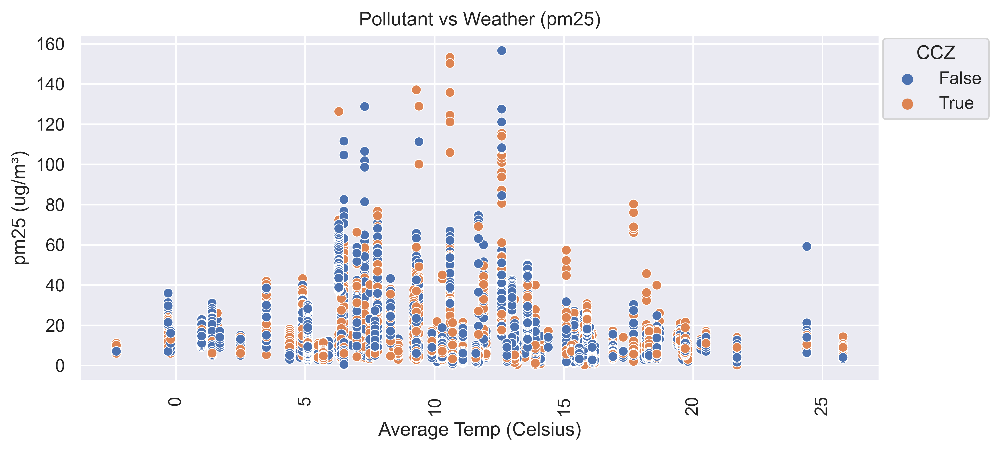

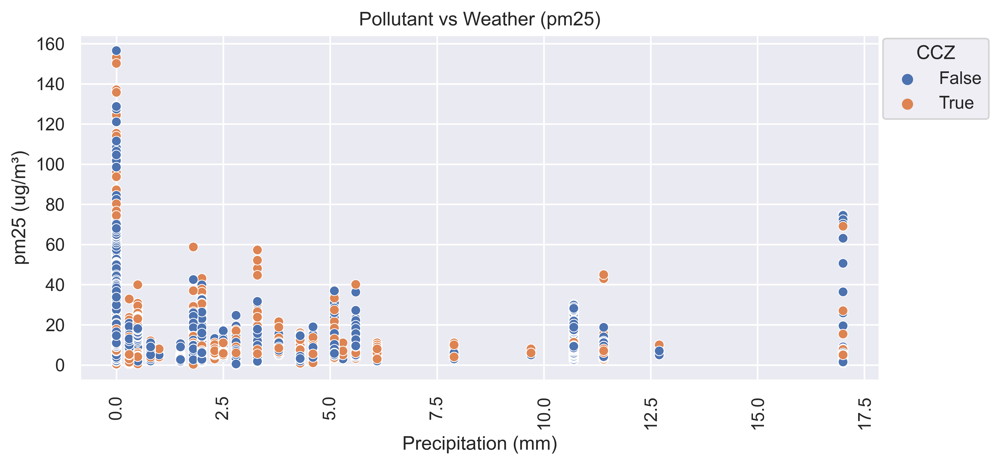

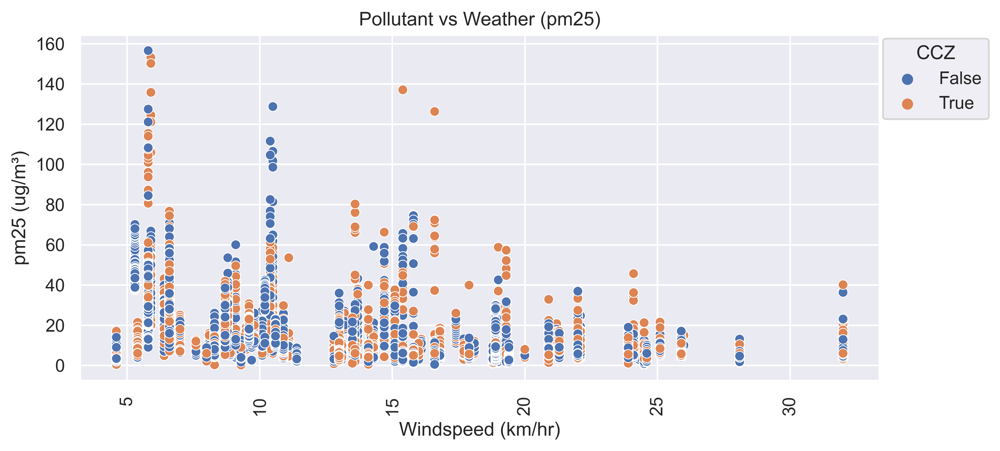

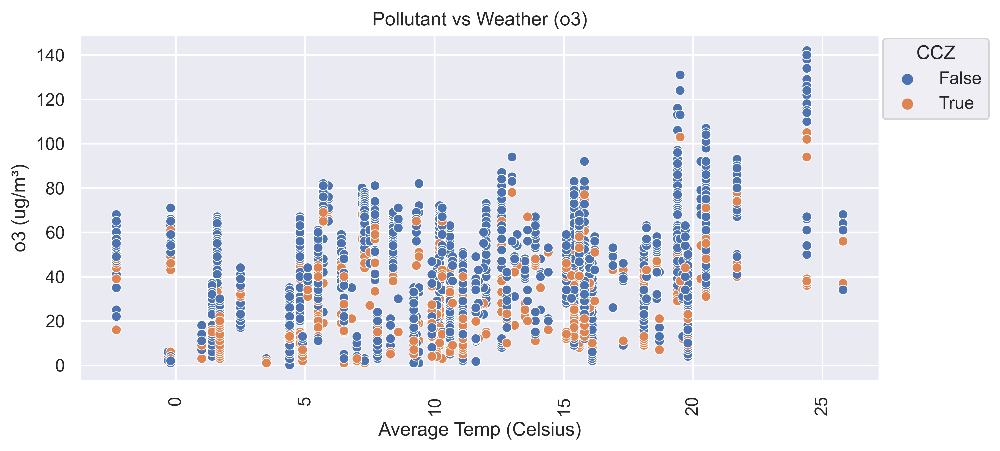

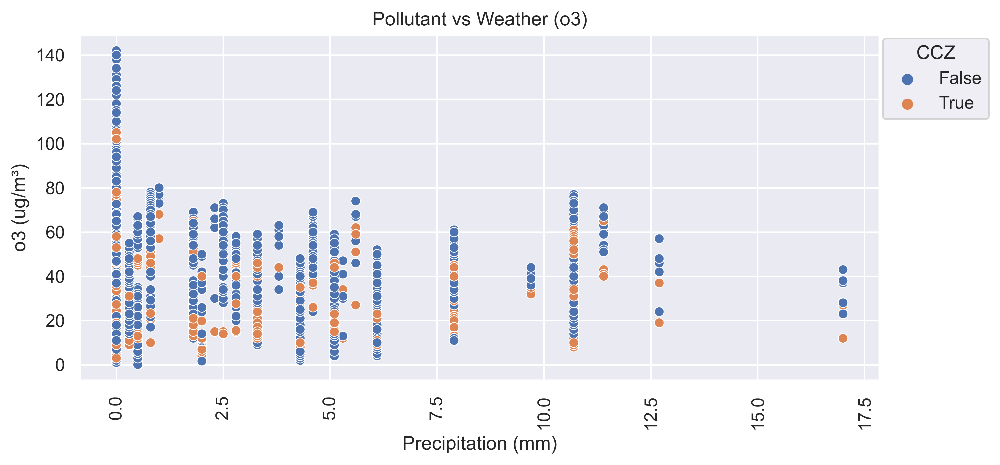

...

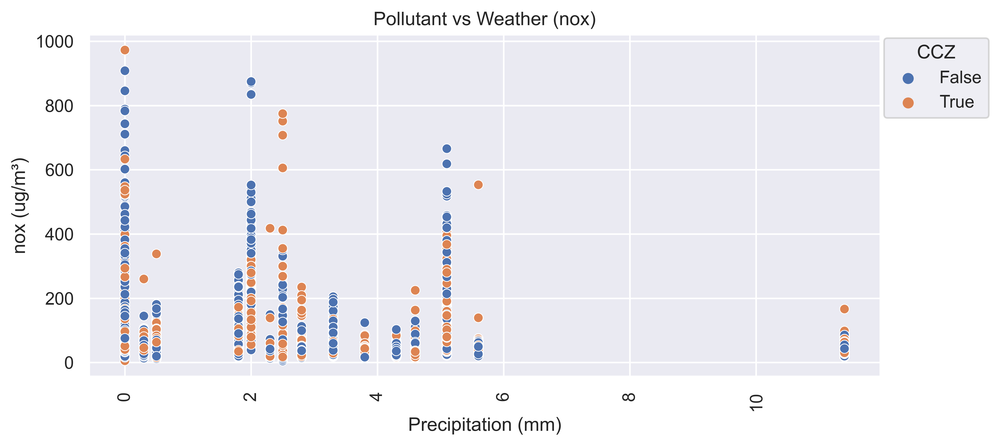

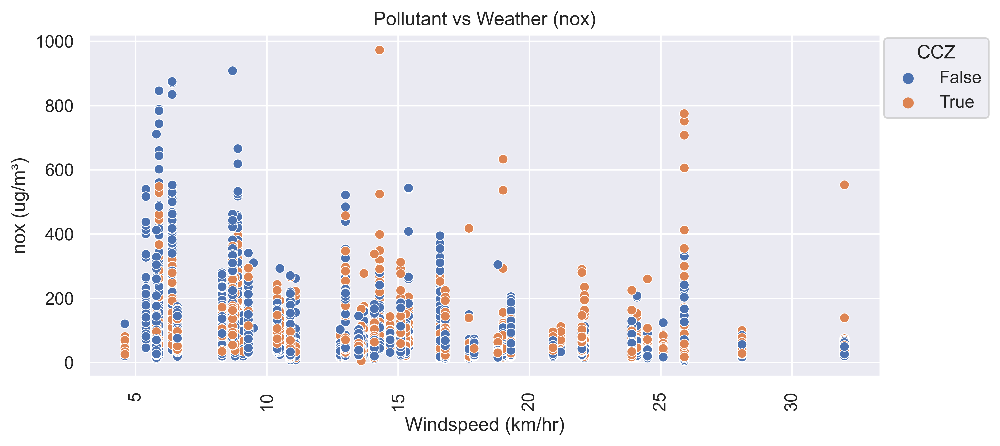

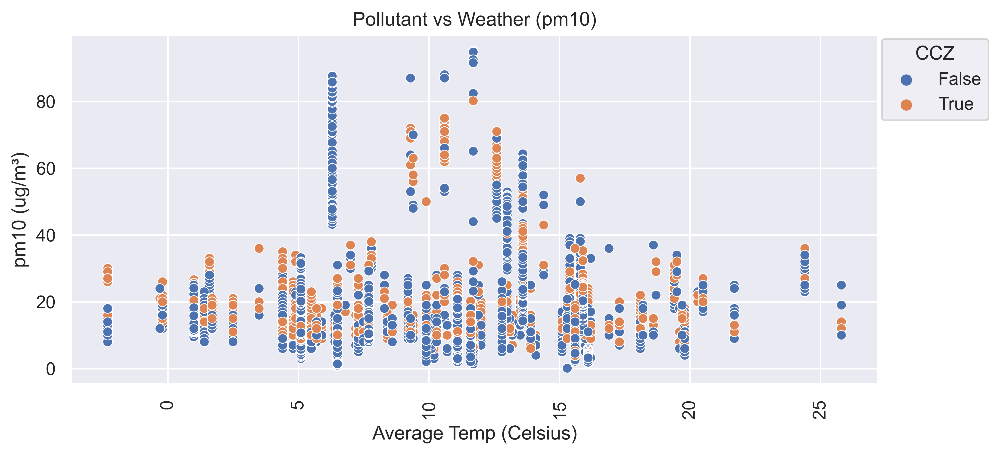

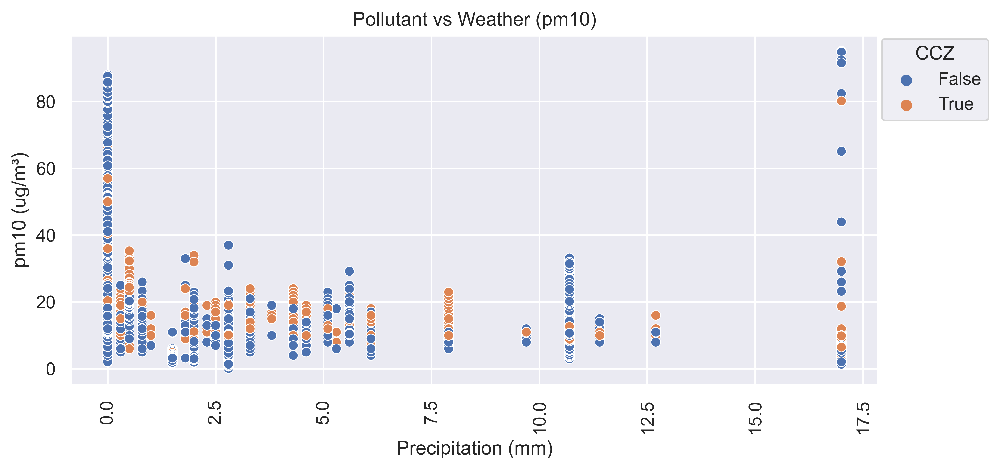

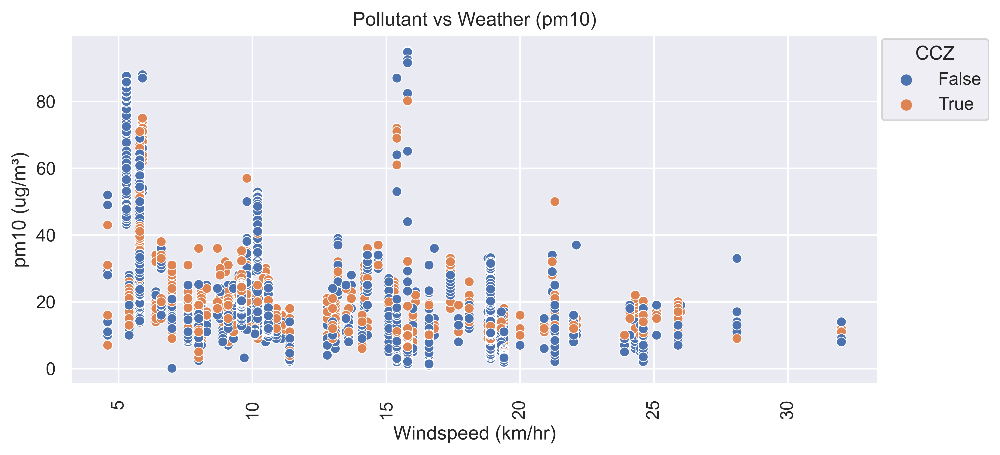

In [12]:
## List the parameters and variables of interest

parameters = ["pm25", "o3", "nox", "pm10"]
weather_params = ["tavg", "prcp", "wspd"]
weather_plotlabels = {"tavg" : "Average Temp", "prcp" : "Precipitation", "wspd" : "Windspeed"} ## Dictionary with labels for plotting

## Define weather units for plotting
## Defined at https://dev.meteostat.net/formats.html#meteorological-parameters

weather_units = {"tavg" : "Celsius", "prcp" : "mm", "wspd" : "km/hr"}  ## Dictionary with units for each weather measurement

## For each parameter and weather variable combination, produce a scatter plot for the non-log values to see what 
## the data looks like

for params in parameters:
    for weather in weather_params:
        
        fig = plt.figure(figsize = (9,4))

        plt.xticks(rotation=90) ## Improve label readability 

        None ## Prevents printing of the x-ticks separate from plot
        
        ## Plot a scatterplot of weather vs value colored by "In_Central" ie CCZ 
        
        sns.scatterplot(x=weather, y="value", data=aqi_weather.loc[aqi_weather['parameter'] == params], 
                        hue="In_Central").set_title(f'Pollutant vs Weather ({params})')
        
        plt.ylabel(params + " (ug/m\u00b3)") ## y-axis label for pollutant with unit
        plt.xlabel(f'{weather_plotlabels[weather]} ({weather_units[weather]})') ## x-axis label for weather with unit
        plt.legend(bbox_to_anchor=(1, 1), loc=2, borderaxespad=0.2, title = "CCZ") ## Places the legend outside of the plot for visualization
        plt.show()

**Commentary**

Given ppm 2.5 (pm25), ppm 10 (pm10), nitrogen oxides (NOx) show non-contant variance, it would be preferable to perform a log transformation on them; however, given they also appear to have negative slopes, it is not valid to perform a log-transformation because this removes negativity when exponentiating back to original units. Given this is not a statistics course, we won't worry about it for now, and we will simply run a regression on non-transformed values to account for the negativity; however, we would recommend finding another transformation (potentially box-cox) or running a generalized model to account for the non-normality and non-linearity.

The following plots explore the log transformation to show how it does indeed normalize some of the plots but removes negativity (particularly for pm25 and pm10 vs windspeed).

We'd also like to note that the presence of the CCZ does appear to have an effect in some datasets, particularly for O3 where it appears to be negatively correlated with pollution values, but this will be explored further in the regression.

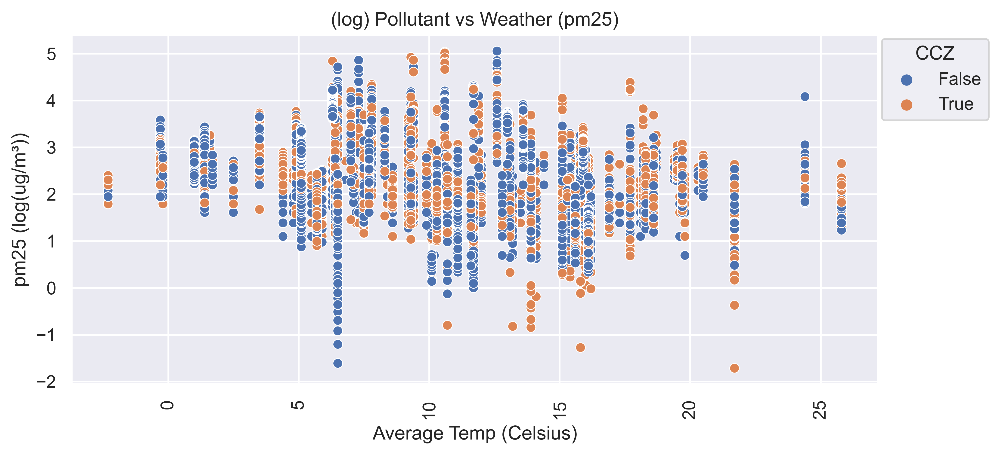

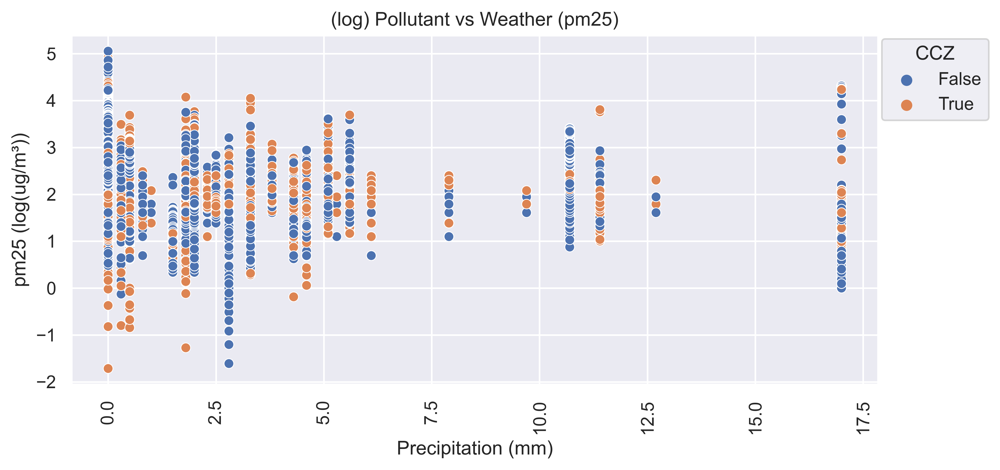

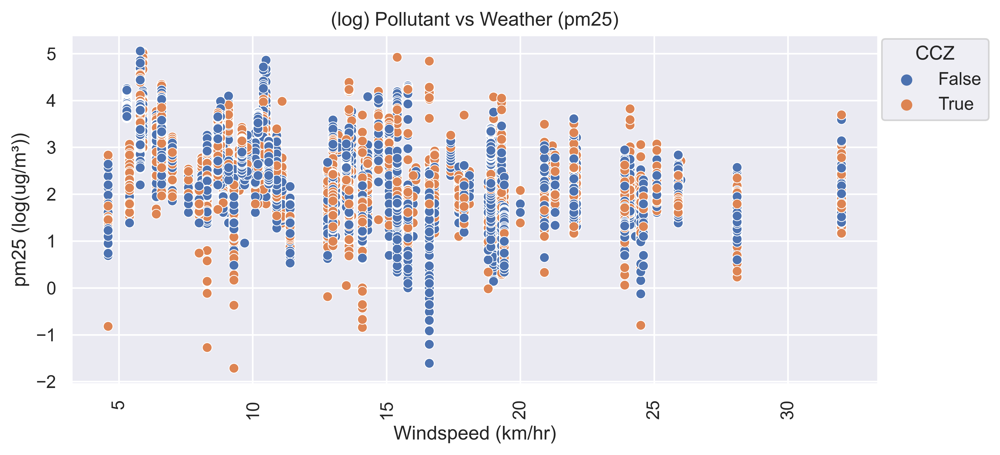

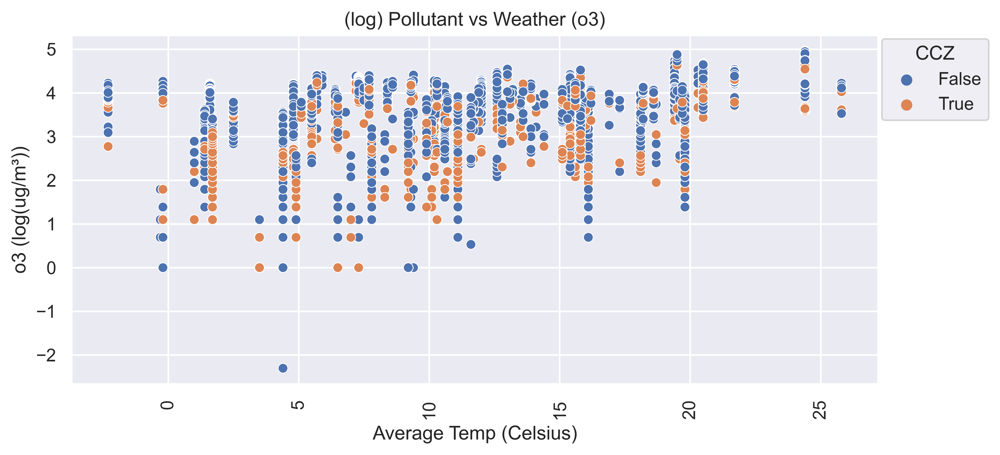

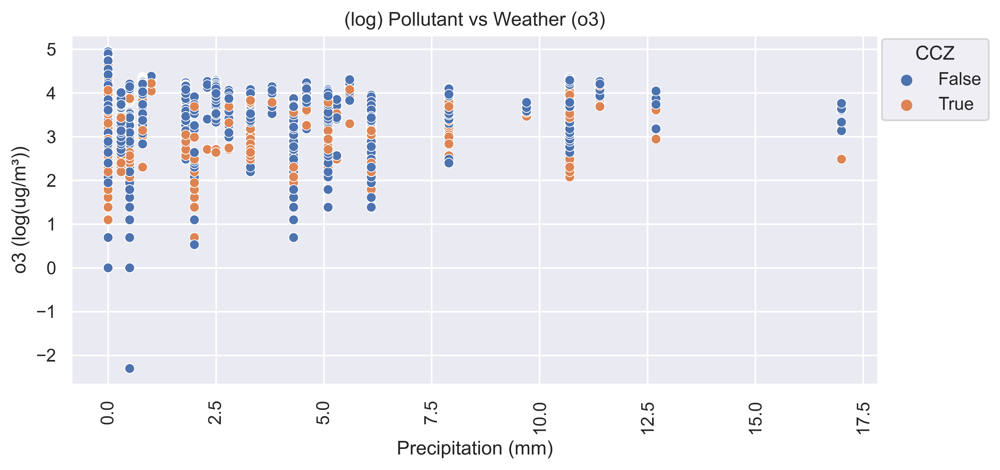

...

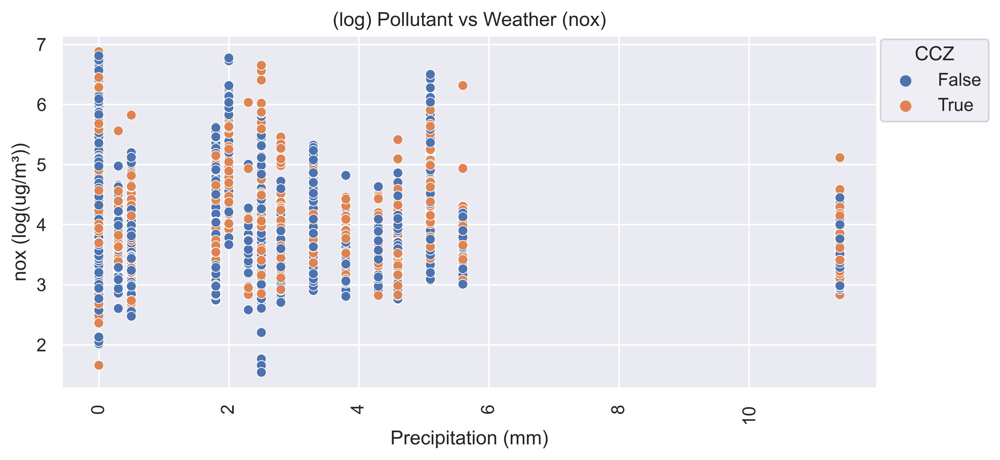

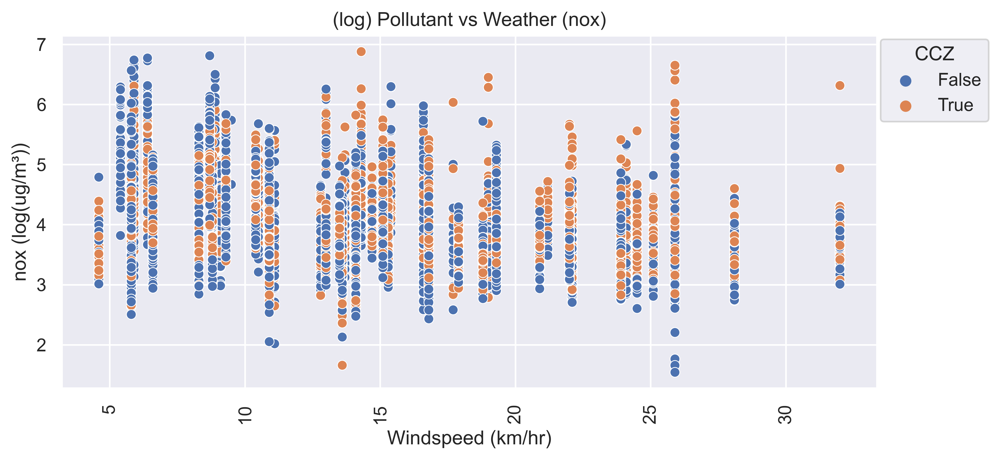

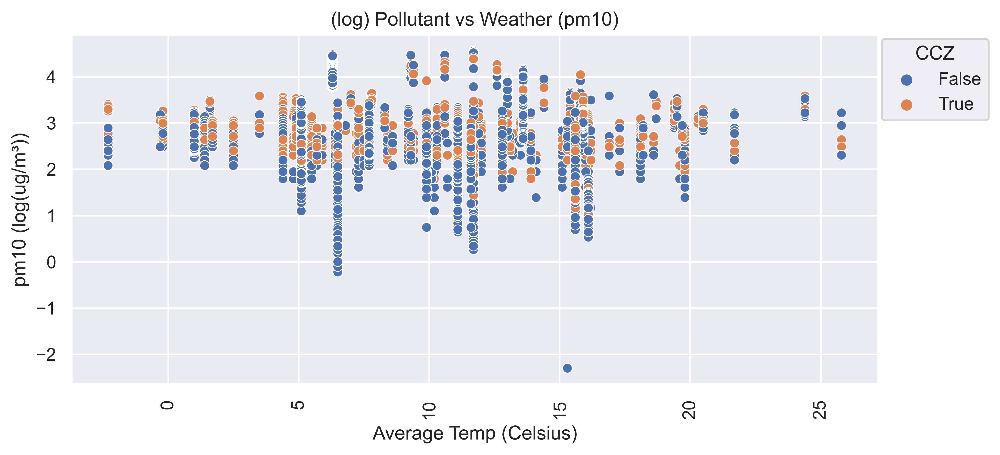

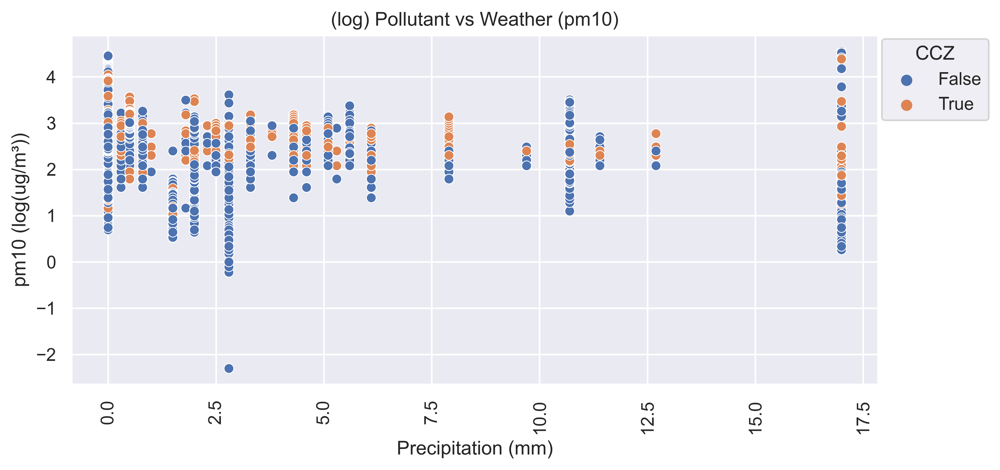

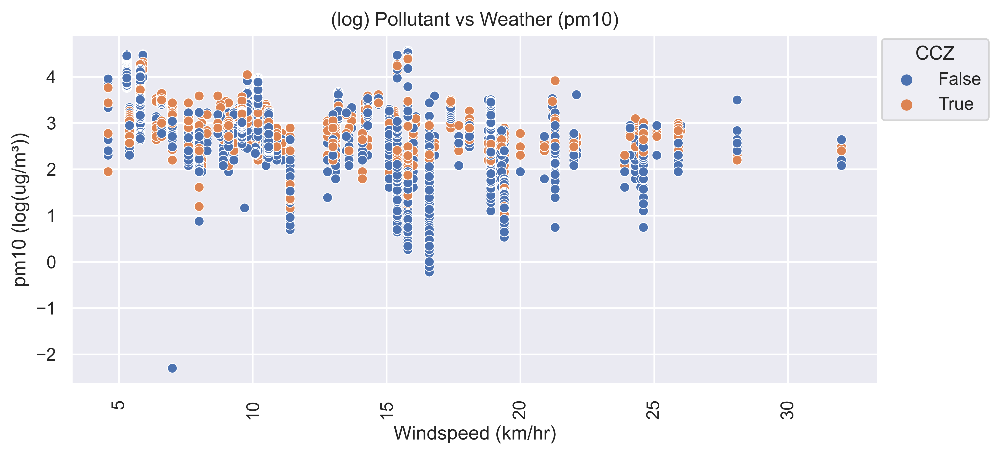

In [13]:
## For each parameter and weather variable combination, produce a scatter plot for the log values to see what the 
## data looks like

for params in parameters:
    for weather in weather_params:
        
        fig = plt.figure(figsize = (9,4))

        plt.xticks(rotation=90) ## Make labels easier to see

        None ## Prevents printing of the x-ticks separate from plot
        
        ## Plot a scatterplot of weather vs value colored by "In_Central" ie CCZ 
        
        sns.scatterplot(x=weather, y="log_params", data=aqi_weather.loc[aqi_weather['parameter'] == params], 
                        hue="In_Central").set_title(f'(log) Pollutant vs Weather ({params})')
        
        plt.ylabel(f'{params} (log(ug/m\u00b3))') ## y-axis label for pollutant with unit
        plt.xlabel(f'{weather_plotlabels[weather]} ({weather_units[weather]})') ## x-axis label for weather with unit (defined in last cell)
        plt.legend(bbox_to_anchor=(1, 1), loc=2, borderaxespad=0.2, title = "CCZ") ## Places the legend outside of the plot for visualization
        plt.show()

**Commentary**

The above plots show that a log transformation does indeed improve linearity and variance, as mentioned above, pm25 and pm10 appear to have negative slopes. While the log-transformation is appealing because it makes them linear, when we exponentiate the values to get back to $ug/m^3$, the negativity will disappear, so we will model without the transformation even though the data is non-normal. Again, we suggest running a general linear model to account for the non-normal data, but given this isn't a statistics course, we will not worry about this issue. 

The package used to generate the linear regression is called statsmodels.api, and it was installed through conda (also in the environment.yml).

In [14]:
## Running regression

## Set up regression model for statsmodels.api regression

model_data = aqi_weather[['parameter', 'log_params', 'value', 'tavg','prcp', 'wspd','In_Central']]
model_data = model_data.dropna() ## Exclude any incomplete cases

params = ['o3', 'pm25','pm10', 'nox'] ## List of parameters to do a regression on

## Create a list to store all results

results = []
i = 0 ## Counter to index results

## Run for parameters not on log scale
## Create design matrix X (from y = X'B in regression model where B is parameters)

for params in params:
    Y, X = dmatrices('value ~ tavg + prcp + wspd + In_Central', 
                     data=model_data.loc[model_data['parameter'] == params], 
                     return_type='dataframe') 

    ## Run multiple regression model and summarize    
    ## Handles categorical variables (like In_Central) by transforming to indicator variables
    ## Adds an intercept by default
    
    model = sm.OLS(Y, X) ## Describes the model to run
    results.append(model.fit()) ## Fits the model
    print(f'\033[1m Regression summary for: {params} \033[0m') ## Print summary in bold
    print(results[i].summary())
    
    ## Visually separate plot results
    print("----------------------------------------------------------------------------------------------------") 
    print("\n")


    ## Plot partial regression plots (ie changes in one explanatory variable while keeping others constant)
    ## and qq-plot

#     fig = plt.figure(figsize=(8, 6))
#     plt.title(params)
#     sm.graphics.plot_regress_exog(results[i], "wspd", fig = fig)
#     sm.qqplot(results[i].resid)
#     fig.tight_layout(pad=1)
    
    i += 1 ##increase the iterator for results storage

 Regression summary for: o3 
                            OLS Regression Results                            
Dep. Variable:                  value   R-squared:                       0.135
Model:                            OLS   Adj. R-squared:                  0.134
Method:                 Least Squares   F-statistic:                     110.7
Date:                Thu, 09 Dec 2021   Prob (F-statistic):           9.62e-88
Time:                        12:48:05   Log-Likelihood:                -12793.
No. Observations:                2835   AIC:                         2.560e+04
Df Residuals:                    2830   BIC:                         2.563e+04
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
Interce

**Regression Conclusions**

We have plotted the residuals and qq-plot on our own to confirm the assumptions of linearity and normality (not shown here for brevity, but the code is included above and commented out). From the residual plots, the only variable that can be accurately described by a normal linear model is O3. All the rest do not meet assumptions of normality or linearity. As mentioned before, we recommend either a transformation (potentially box-cox) or a generalized linear model to accurately analyze the data. We, however, will not focus on this for this analysis and will interpret the results here pretending the model was a valid model to run. 

We will, however, draw conclusions for the models where all parameters are significant (O3, PM10, PM25, NOx) (even though assumption of linearity is not met for most). Note that the intercepts refer to the condition when a location is not in CCZ, the temperature is 0 Celsius, there is no rain, and there is no wind. We won't address the intercept in the following.

First we will look at O3 (ozone). For O3, all explanatory variable coefficients were significant. The coefficient for Central Status (CCZ True) is -13.6 (-15.4, -11.7), suggesting that O3 levels in the CCZ are 13.6 $ug/m^3$ lower than outside of the CCZ, on average. The coefficients for the remaining predictors were fairly low, suggesting a significant but minimal impact of weather on O3 levels in London. The coefficient for average temperature was 0.57 (0.44, 0.70), suggesting an increase of 0.57 $ug/m^3$ for each unit increase in average temperature (in Celsius). The coefficient for precipitation was -0.70 (-0.92, -0.47), suggesting a decrease of 0.70 $ug/m^3$ for each unit increase in precipitation (mm of rain). The coefficient for windspeed was 0.76 (0.62, 0.90), suggesting an increase of 0.76 $ug/m^3$ for each unit increase in windspeed (km/h). Lastly, the intercept was 28.7 (26.3, 31.2), suggesting that baseline O3 (Not in CCZ, 0 Celsius, No rain, No wind) is 28.7 $ug/m^3$.

Overall, the biggest takeaway for O3 is that the CCZ seems to reduce O3 levels relative to outside of the CCZ, which is in agreement with our hypothesis. Effects from weather are small, but with large increases in each variable, there would likely be a noteworthy effect on O3. Interestingly, while temperature and precipitation have an effect in the direction of our hypothesis (temperature increases levels and precipitation decreases levels), windspeed seems to have the opposite effect (higher wind speeds are associated with higher O3 levels).

Next we will look at PM10 (respirable particulate matter). For PM10, all coefficients were significant, but they were, again, fairly low, suggesting significant but minimal impact of all predictor variables on PM10 levels in London. The coefficient for Central Status (CCZ True) is -1.01 (-1.70, -0.33), suggesting that PM10 levels in the CCZ are essentially the same as PM10 levels outside of the CCZ (1.01 $ug/m^3$ lower in CCZ). The coefficient for average temperature is -0.187 (-0.248, -0.126), suggesting a slight decrease of 0.187 $ug/m^3$ in PM10 for each unit increase in temperature. The coefficient for precipitation is -0.507 (-0.586, -0.428), suggesting a slight decrease of 0.507 $ug/m^3$ in PM10 for each unit increase in precipitation. The coefficient for windspeed is -1.38 (-1.440, -1.316), suggesting a slight decrease of 1.38 $ug/m^3$ in PM10 for each unit increase in windspeed. 

Altogether, the results for PM10 suggest that these predictor variables don't have much impact on PM10 levels. For the CCZ, the impact is essentially non-existent. For the weather variables, you would need to see a large increase in given weather (significantly higher temperatures, rain, or windspeed) to see an effect on PM10. Again, windspeed seems to have an observed effect in the opposite direction of our hypothesis. We would expect higher windspeeds to lower PM10, but it seems to increase it in London. The other weather variables are in line with our hypothesis (higher temperature associated with higher pollutant levels and higher precipitation associated with lower pollutant levels).

Next we will look at PM25 (fine particulate matter). For PM25, all coefficients were significant, but they were, again, fairly low, suggesting significant but minimal impact of all predictor variables on PM25 levels in London. The exponentiated coefficient for Central Status (CCZ True) is -0.444 (-0.798, -0.091), so that PM25 levels in the CCZ are essentially the same as PM25 levels outside of the CCZ. The coefficient for average temperature is -0.475 (-0.506, -0.443), suggesting a slight decrease of 0.475 $ug/m^3$ in PM25 for each unit increase in temperature. The coefficient for precipitation is -0.570 (-0.625, -0.516), suggesting a slight decrease of 0.570 $ug/m^3$ in PM25 for each unit increase in precipitation. The coefficient for windspeed is -0.917 (-0.948, -0.887), suggesting a slight decrease of 0.917 $ug/m^3$ in PM25 for each unit increase in windspeed.

Similar to PM10, the results for PM25 suggest that these predictor variables don't have much impact on PM25 levels. For the CCZ, the impact is, again, essentially non-existent. For the weather variables, you would need to see a large increase in given weather variables to see an effect on PM25. For PM10, all predictor effects are in the same direction as our hypotheses except for temperature. We would expect higher temperature to be associated with higher pollutants, but here it appears that higher temperatures are associated with lower PM10, although it is a very low association.

Finally, the explanatory variable coefficients of NOx (nitrogen oxides) were significant. The coefficient of central state (CCZ True) is -6.14 (-9.229, -3.054), indicating that NOx levels are on average 6.14 $ug/m^3$lower within CCZ than outside CCZ. The coefficients of other predictors are higher than those of PM10, PM2.5 and O3, indicating that weather has a significant and certain impact on NOx levels in London. The average temperature coefficient is -2.5(-2.8, -2.19), indicating a decrease of $2.50 ug/m^3$per unit of average temperature. Precipitation coefficients were 1.18(0.47, 1.89), indicating an increase of 1.18 $ug/m^3$ per unit of increased precipitation (mm of rain). Wind speed coefficient is 3.42 (3.692, 3.147), showed that wind speed (km/h) per unit to reduce 3.42 $ug/m ^ 3 $.

Among all pollutants, NOx has the most obvious relationship with weather change, and CZZ also reduces the level of NOx compared with outside the CCZ. Large changes in weather factors were likely to have a noticeable effect on NOx levels. However, different from our hypothesis, temperature has a negative effect on NOx, while precipitation has a positive effect on NOx. Only windspeed has an effect in the direction of our hypothesis (the negative effect).

In general, the results show that the weather variables (windspeed, temperature, and precipitation) are associated with pollutant levels, and while the degree and direction of association vary depending on the pollutant, windspeed is consistently negatively associated with pollutant levels (which makes intuitive sense). Also, the existence of the CCZ tends to be associated with lower pollutant levels relative to outside the CCZ, where it has a strong positive correlation (which requires further investigation). 


### **Further Analysis of Weather Parameters**

Thus far we have looked at the impact of the Congestion Charge Zone on pollution levels. To explore the relationship between weather and pollution further, we have identified additional weather stations within and outside the Congestion Charge Zone.

In the Congestion Charge Zone, we identified one weather station with id 03779, which is the London Weather Centre. We collected daily meteorological data for this site, including the mean temperature (tavg), the minimum temperature (tmin), the maximum temperature (tmax), the average wind direction (wdir) and the average wind speed (wspd). Additional parameters were not considered due to gaps in our collected data, such as snow depth (snow) and daily sunshine (tsun).

Outside the Congestion Charge Zone, four additional weather stations were selected with IDs 03672, 03772, EGKB0 and EGLC0. The data from these stations were averaged to obtain means for the abovementioned meteorological parameters. These will then be used in our analysis to contrast and calculate correlations with data from within the Congestion Charge Zone. 

**First, we identify weather sensors in Congestion Charge Zone by importing the functions from Meteostat api**

In [7]:
# Identify weather sensors in Congestion Charge Zone by importing the functions from Meteostat api
# Stations() is the class of the Meteostat api dataset

stations = Stations()

# Use of bounds() function to find the weather sensors in congestion charging zone. 
# Function collects all weather sensors in a block where top left of block is defined by the latitude and longitude of 
# the first tuple, and bottom right is the latitude and of the second tuple
# fectch() selects all of the sensors in the defined block.

stations = stations.bounds((51.520063, -0.169285), (51.502433, -0.065144)).fetch()


# Find the ID of the Congestion Charging Zone sensor
# We initiale the index of the dataframe id_of_congestion_sensor, it will be helpful in the following data slicing

id_of_congestion_sensor = stations.reset_index()

# Since the first column of id_of_congestion_sensor is the ID of the weather sensors, the id_of_congestion_sensor 
# only contains the ID of weather sensors after iloc slicing.
# For extracting the weather data from each sensor, the ID of weather sensors will be used in following data 
# extracting function from Meteostat

id_of_congestion_sensor = id_of_congestion_sensor.iloc[0,0]

# Print all IDs of weather sensors in the Congestion Charge Zone

print("IDs of weather stations within the Congestion Charge Zone:")
print(id_of_congestion_sensor)

IDs of weather stations within the Congestion Charge Zone:
03779


**Next we find sensors outside of congestion zone**

In [8]:
# Find sensors in non_congestion_zone
# Define non_congestion_and_congestion as the class in the Meteostat api

non_congestion_and_congestion = Stations()

# Identify all of the sensors in non Congestion Charge Zones and Congestion Charge Zones

non_congestion_and_congestion = non_congestion_and_congestion.bounds((51.685747, -0.526012), (51.287660, 0.348896)).fetch()

# drop() function is used to remove the Congestion Charge Zone sensors

non_congestion = non_congestion_and_congestion.drop(index = id_of_congestion_sensor)

# Find ID of the non Congestion Charging Zone sensors 
# Reset the index of the id_of_non_congestion_sensor

id_of_non_congestion_sensor = non_congestion.reset_index()

# ID and name are first and second columns in dataframe id_and_name_of_uncongestion_sensor
# Define the data of id and name as id_and_name_of_non_congestion_sensor 

id_and_name_of_non_congestion_sensor = id_of_non_congestion_sensor.iloc[:,0:2]

# Print ID of non Congestion Charge Zone sensors 

print("ID of weather stations outside the Congestion Charge Zone:")
print(id_and_name_of_non_congestion_sensor)

ID of weather stations outside the Congestion Charge Zone:
      id                         name
0  03672                     Northolt
1  03772      London Heathrow Airport
2  03781                       Kenley
3  EGKB0  Biggin Hill / berry's green
4  EGLC0          London / Abbey Wood
5  EGTI0    Leavesden / North Watford


**Now we set the time period for analysis (same as before: from January 1, 2018) and pull data from meteostat**

In [10]:
# Set time period of analysis, from 2018/1/1 (Y/M/D) to present for Congestion Charge Zone
from datetime import datetime ##specifically access the datetime function

start = datetime(2018, 1, 1)
end = datetime(2022, 1, 1)


# Select only the daily data from Meteodata using sensor ID 03779
# Use Daily() from Meteostat api to excract the daily weather data between start and end date

congestion_zone = Daily('03779', start, end).fetch()


# Take the average weather data of sensors in each month
# resample() is used to resample the datarame according to the month ('M') 
# After resampling the data accroding to month, take average values of all daily data in that month 
# Define monthly data in Congestion Charge Zone sensors as congestion_zone_Monthly

congestion_zone_Monthly = congestion_zone.resample('M', kind='period').mean()


# Drop factors with insufficient data for analysis

congestion_zone_Monthly = congestion_zone_Monthly.drop(columns = ['snow', 'tsun', 'prcp', 'pres', 'wpgt'])


# Save Congestion Charge Zone weather data as CSV

#congestion_zone_Monthly.to_csv('./Datasets/congestion_zone_Monthly.csv')

In [11]:
# Repeat process for non Congestion Charge Zones, 4 sensors to consider
# Sensor data outside Congestion Charge Zone will be extracted and sliced by ID, the starting and ending time
# resample each sensor and take the average value on each month to get the monthly data

non_congestion_zone_Northolt = Daily('03672', start, end).fetch()
non_congestion_zone_Northolt_Monthly = non_congestion_zone_Northolt.resample('M', kind='period').mean()

non_congestion_zone_London_Heathrow_Airport = Daily('03772', start, end).fetch()
non_congestion_zone_London_Heathrow_Airport_Monthly = non_congestion_zone_London_Heathrow_Airport.resample('M', kind='period').mean()

non_congestion_zone_Biggin_Hill_berry_s_green = Daily('EGKB0', start, end).fetch()
non_congestion_zone_Biggin_Hill_berry_s_green_Monthly = non_congestion_zone_Biggin_Hill_berry_s_green.resample('M', kind='period').mean()

non_congestion_zone_London_Abbey_Wood = Daily('EGLC0', start, end).fetch()
non_congestion_zone_London_Abbey_Wood_Monthly = non_congestion_zone_London_Abbey_Wood.resample('M', kind='period').mean()

In [12]:
# Merge all data from non Congestion Charge Zones 

result = pd.concat([non_congestion_zone_Northolt_Monthly, non_congestion_zone_London_Heathrow_Airport_Monthly, non_congestion_zone_Biggin_Hill_berry_s_green_Monthly, non_congestion_zone_London_Abbey_Wood_Monthly],axis=1, keys=['Northolt_Monthly','London_Heathrow_Airport_Monthly','Biggin_Hill_berry_s_green_Monthly','London_Abbey_Wood_Monthly'],names=['Area:','Parameters:'])
print("Merged Dataset with all congestion zone data together:")
print(result)

Merged Dataset with all congestion zone data together:
Area:       Northolt_Monthly                                                   \
Parameters:             tavg       tmin       tmax      prcp snow        wdir   
time                                                                            
2018-01             6.110345   3.155172   8.993103       NaN  NaN  206.771429   
2018-02             3.210714  -0.264286   6.371429       NaN  NaN  175.361905   
2018-03             5.717241   2.575862   9.155172       NaN  NaN  155.904348   
2018-04            11.234483   7.641379  15.175862       NaN  NaN  183.775000   
2018-05            14.587097   8.893548  19.964516       NaN  NaN  123.083333   
2018-06            17.713333  12.523333  23.033333       NaN  NaN  144.710345   
2018-07            21.451613  15.470968  27.158065  1.645455  NaN  187.418519   
2018-08            18.387097  13.422581  23.448387  1.932258  NaN  243.809677   
2018-09            14.823333   9.700000  20.116667  0.

**As you can see in the above data, there are many missing data values. We need to delete them to move forward with the analysis**

In [13]:
# The dataset indicates numerous null values for snow, tsun, prcp, pres and wpgt, these shall be removed
# There are many null values for Zone 'Biggin_Hill_berry_s_green_Monthly', we shall also remove this Zone

result.info()

<class 'pandas.core.frame.DataFrame'>
PeriodIndex: 48 entries, 2018-01 to 2021-12
Freq: M
Data columns (total 40 columns):
 #   Column                                     Non-Null Count  Dtype  
---  ------                                     --------------  -----  
 0   (Northolt_Monthly, tavg)                   48 non-null     float64
 1   (Northolt_Monthly, tmin)                   48 non-null     float64
 2   (Northolt_Monthly, tmax)                   48 non-null     float64
 3   (Northolt_Monthly, prcp)                   42 non-null     float64
 4   (Northolt_Monthly, snow)                   0 non-null      float64
 5   (Northolt_Monthly, wdir)                   48 non-null     float64
 6   (Northolt_Monthly, wspd)                   48 non-null     float64
 7   (Northolt_Monthly, wpgt)                   40 non-null     float64
 8   (Northolt_Monthly, pres)                   48 non-null     float64
 9   (Northolt_Monthly, tsun)                   0 non-null      float64
 10  (London_

**Here we put the data together to construct dataframes of monthly weather data within and outside the Congestion Charge Zone**

In [14]:
# Concatenate average Monthly data in non Congestion Charge Zones

result = pd.concat([non_congestion_zone_Northolt_Monthly, non_congestion_zone_London_Heathrow_Airport_Monthly, non_congestion_zone_London_Abbey_Wood_Monthly],axis=1)

# Remove parameters with numerous null values 

result = result.drop(columns = ['snow', 'tsun', 'prcp', 'pres', 'wpgt'])

# Rename columns to indicate data represents the average value of all non Congestion Charge Zone sensors

# Processing tavg average temperature parameters
tavg_mean = result['tavg'].mean(axis=1).to_frame().rename(columns={0: "tavg_mean"})

# Processing tmin minimum temperature parameters
tmin_mean = result['tmin'].mean(axis=1).to_frame().rename(columns = {0: "tmin_mean"})

# Processing tmax maximum temperature parameters
tmax_mean = result['tmax'].mean(axis=1).to_frame().rename(columns = {0: "tmax_mean"})

# Processing wdir wind direction parameters
wdir_mean = result['wdir'].mean(axis=1).to_frame().rename(columns = {0: "wdir_mean"})

# Processing wspd wind speed parameters
wspd_mean = result['wspd'].mean(axis=1).to_frame().rename(columns = {0: "wspd_mean"})

# Concatenate all averages to new dataframe
non_congestion_zone_mean = pd.concat([tavg_mean,tmin_mean,tmax_mean,wdir_mean,wspd_mean],axis=1)

# Display the data in non_congestion_zone_mean dataframe
print(non_congestion_zone_mean)

# Save the non_congestion data as CSV
#non_congestion_zone_mean.to_csv('./Datasets/non_congestion_zone_mean_Monthly.csv')

         tavg_mean  tmin_mean  tmax_mean   wdir_mean  wspd_mean
time                                                           
2018-01   6.754846   4.073946   9.394253  206.883069  18.357674
2018-02   3.715476   0.777381   6.545238  173.925265  15.453263
2018-03   6.143023   3.283065   9.336169  163.818956  16.492414
2018-04  11.540780   8.170777  15.272748  186.932553  15.073444
2018-05  15.011531   9.933667  20.212792  173.194444  12.300408
2018-06  18.043372  13.349732  23.292299  173.424877  14.276169
2018-07  21.814624  16.516129  27.224731  175.482248  12.882939
2018-08  18.974659  14.684588  23.651613  244.619062  13.235950
2018-09  15.220222  10.818889  20.127778  220.736825  13.916389
2018-10  12.195662   8.469410  16.360994  223.022342  12.715054
2018-11   9.095556   6.215556  11.914444  140.113162  14.451111
2018-12   8.153763   5.322581  10.494624  212.631864  15.025806
2019-01   5.005339   2.183908   7.315091  254.869409  13.313756
2019-02   7.639286   3.766667  12.027381

Now that we have constructed dataframes of monthly weather data within and outside the Congestion Charge Zone, we shall consider how they vary with respect to pollutants. For our analysis we have selected PM2.5 and NOx. 

### **(1) Analysis of PM2.5 with respect to Weather**

**First we get data in monthly format for our analysis**

In [41]:
# Read the weather data CSVs

congestion_zone_mean_Monthly = pd.read_csv('./Datasets/congestion_zone_Monthly.csv', index_col = 0)
non_congestion_zone_mean_Monthly = pd.read_csv('./Datasets/non_congestion_zone_mean_Monthly.csv', index_col = 0)

# Generate aggregate data for average pollution within and outside the CCZ

# For each month group by month_year, location status (In_central), parameter (pm25) and units.
# Report mean and output as dataframe reset_index outputs as an ungrouped dataframe

params_central = aqi_weather.groupby(["month_year", "In_Central", "parameter", "unit"])["value"].agg(['mean','std']).reset_index()

# Set time as index of the dataframe and amend the index into datetime type data
# The column month_year in params_central (the pollution dataframe) is the datetime of each data point

params_central['month_year'] = pd.to_datetime(params_central['month_year'])

# Set the datetime of the dataframe as the index of the dataframe

params_central.set_index('month_year', inplace=True)

# For monthly data in Congestion Charge Zones, amend index to datetime data type 

congestion_zone_mean_Monthly = congestion_zone_mean_Monthly.reset_index()
congestion_zone_mean_Monthly['time'] = pd.to_datetime(congestion_zone_mean_Monthly['time'])

# For monthly data in non Congestion Charge Zones, amend index to datetime data type 

non_congestion_zone_mean_Monthly = non_congestion_zone_mean_Monthly.reset_index()
non_congestion_zone_mean_Monthly['time'] = pd.to_datetime(non_congestion_zone_mean_Monthly['time'])

**Now we specifically select the PM2.5 index in Congestion Charge Zone from the pollution dataframe**

In [16]:
# Selecting the PM2.5 index in Congestion Charge Zone from pollution dataframe
# Since the 'In_Central','parameter','unit' columns are not be used in analysis they are dropped

pm25_in_central = params_central.loc[(params_central['parameter'] == 'pm25') & (params_central['In_Central'] == True)].drop(columns = ['In_Central','parameter','unit'])

# Selecting the PM2.5 index outside Congestion Charge Zone from pollution dataframe. 
# Since the 'In_Central','parameter','unit' columns are not be used in analysis they are dropped

pm25_not_in_central = params_central.loc[(params_central['parameter'] == 'pm25') & (params_central['In_Central'] == False)].drop(columns = ['In_Central','parameter','unit'])

# Merge PM25 datasets according to the date time of the each data point. 
# Define the PM2.5 index dataframe as PM25

pm25 = pd.merge(pm25_in_central, pm25_not_in_central, on ='month_year', how = 'left')

# Rename the columns in PM25 to define if inside or outside Congestion Charge Zone 

pm25.columns = ['pm25_in_central','pm25_in_central_std','pm25_not_in_central','pm25_not_in_central_std']

**The next two plots show the PM2.5 data for each month from January 2018 to December 2021**

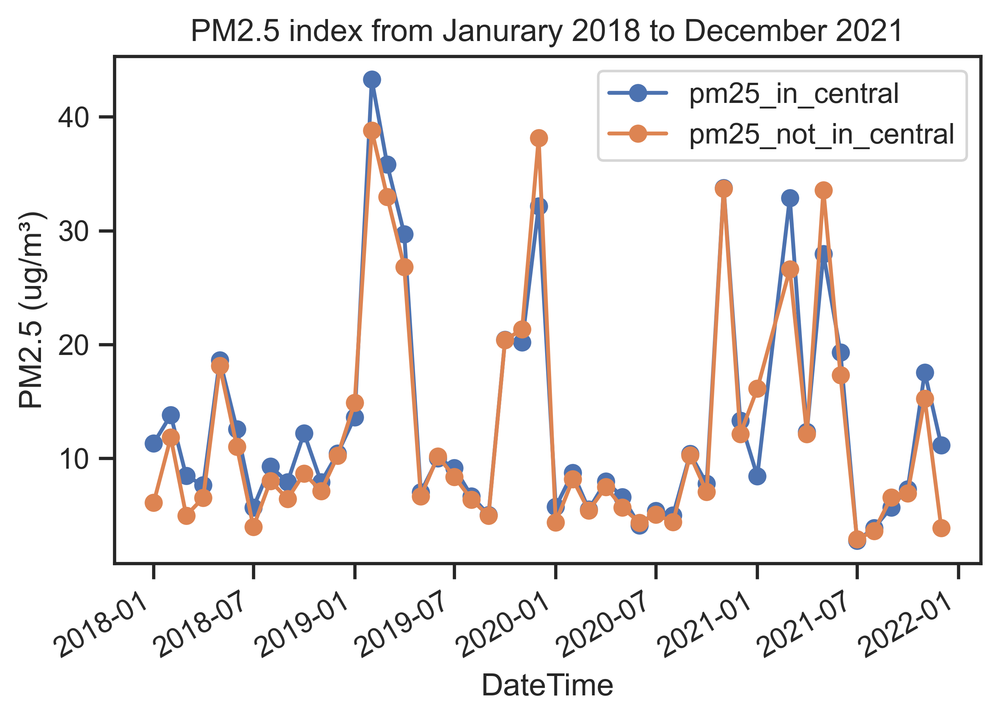

In [18]:
# Plot the PM2.5 data from Janurary 2018 to December 2021
# X-axis - month of each pm2.5 recording, Y-axis - value of PM2.5 

pm25.plot(y = ['pm25_in_central', 'pm25_not_in_central'], marker = 'o')

# Define the x-axis date time
plt.xlabel('DateTime',loc = 'center')

# Define the y-axis PM2.5 index
plt.ylabel('PM2.5 (ug/m\u00b3)',loc = 'center')

# Create Plot Title
plt.title('PM2.5 index from Janurary 2018 to December 2021')

# Display Plot
plt.show()

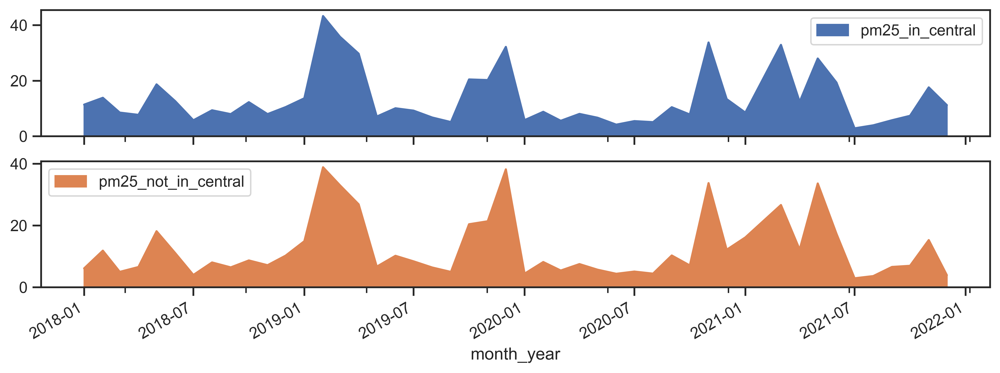

In [23]:
# Display PM25 data in separate subplots 

axs = pm25.plot.area(figsize = (12, 4),y = ['pm25_in_central', 'pm25_not_in_central'],subplots = True)
# Define the x-axis date time
plt.xlabel('DateTime',loc = 'center')

# Define the y-axis PM2.5 index
plt.ylabel('PM2.5 (ug/m\u00b3)',loc = 'center')

# Create Plot Title
plt.title('The overview of PM2.5 index from Janurary 2018 to December 2021')

**Now we plot the standard deviation of the PM25 data to understand the variability across time**

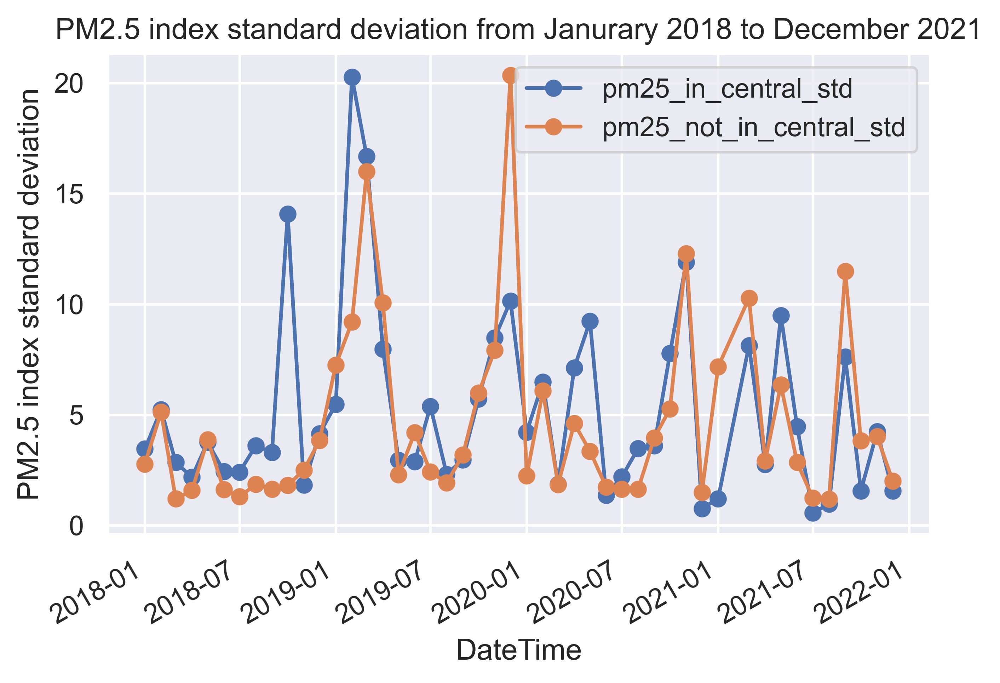

In [68]:
# Plot PM2.5 standard deviations 
# Following same procedure as above 

pm25.plot(y = ['pm25_in_central_std', 'pm25_not_in_central_std'], marker = 'o')
plt.xlabel('DateTime',loc = 'center')
plt.ylabel('PM2.5 index standard deviation',loc = 'center')
plt.title('PM2.5 index standard deviation from Janurary 2018 to December 2021',loc = 'center')
plt.show()

According to the first line chart above, PM2.5 content within the Congestion Charge Zone was higher than that outside the Zone until July 2019. After the end of 2019, PM2.5 levels in the Congestion Charge Zone declined, failing to rise again to their highest point seen in early 2019. In addition, from the "PM2.5 Index Standard Deviation" chart, the volatility of PM2.5 content in the congestion charge zone also decreased after the end of 2019, proving that PM2.5 emissions tend to be flat, and the charging policy implemented in the region is effective to some extent.

Moving forward with our analysis, we shall analyse the annual and monthly pollution changes in the Congestion Charge Zones.

In [25]:
# Since the DateTime column in pm25_in_central dataframe is our index, it extracts the year and month value of 
# the index directly.
# Therefore, reset the index of the dataframe geting the year and month value of the date time

pm25_in_central = pm25_in_central.reset_index()

# Ensure the month_year is the datetime data type

pm25_in_central['month_year'] = pd.to_datetime(pm25_in_central['month_year'])

# Extract the year from the month_year column and define a new column as the year

pm25_in_central['year'] = pm25_in_central['month_year'].dt.year

# Extract the month number from the month_year column and define a new column as the month

pm25_in_central['month'] = pm25_in_central['month_year'].dt.month


# Perform the same operations for pm25_not_in_central 

pm25_not_in_central = pm25_not_in_central.reset_index()
pm25_not_in_central['month_year'] = pd.to_datetime(pm25_not_in_central['month_year'])
pm25_not_in_central['year'] = pm25_not_in_central['month_year'].dt.year
pm25_not_in_central['month'] = pm25_not_in_central['month_year'].dt.month

**The following plots investigate the distribution of PM2.5 in the Congestion Charge Zone both montly and yearly**

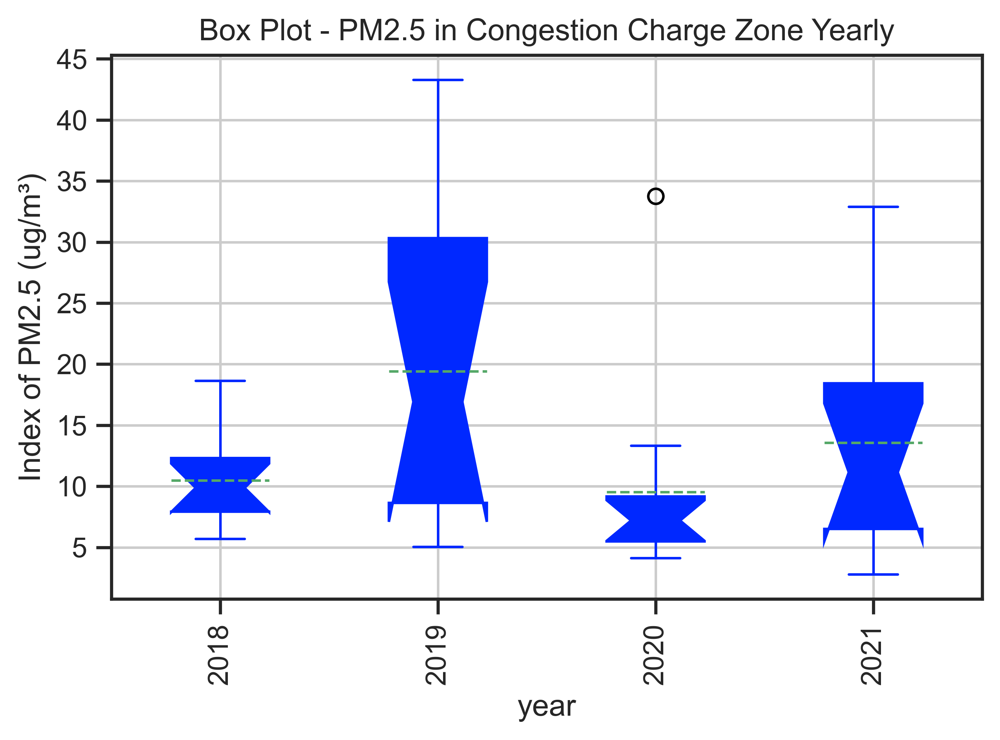

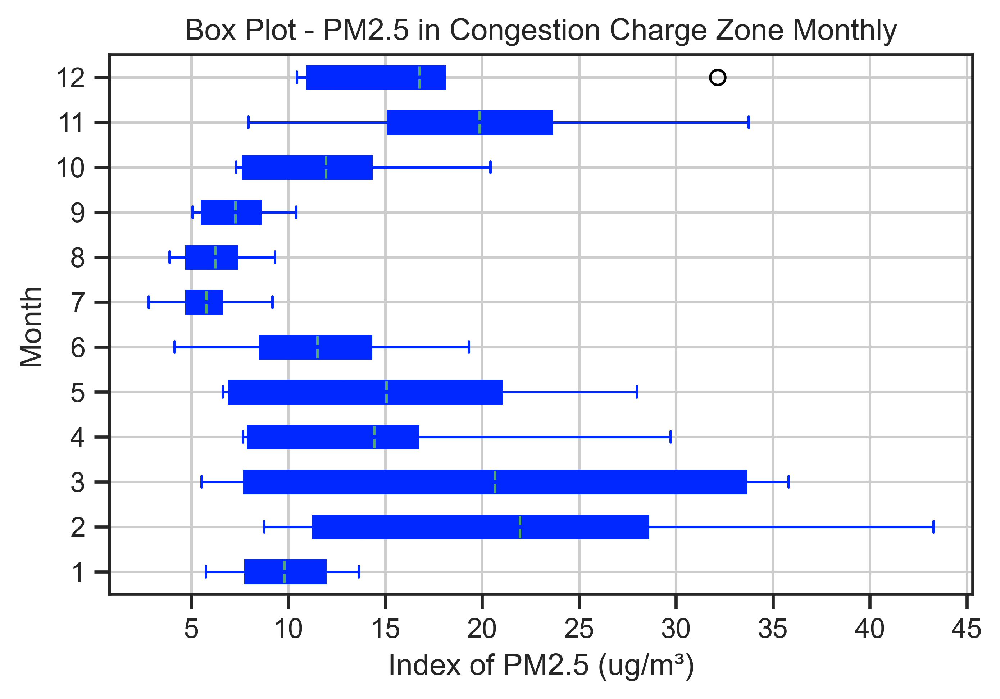

In [28]:
# Plotting a box plot to investigate distribution of PM2.5 index in Congestion Charge Zone Yearly

# The data will be grouped by the year
# Mediam value indicated by notch of the boxplot and the mean as the dotted line.

pm25_in_central.boxplot(by = 'year', column = ['mean'], patch_artist = True, meanline = True,  showmeans = True, showfliers = True, rot= 90, notch = True, color='#0028FF')

# Create Title for Plot

plt.title('Box Plot - PM2.5 in Congestion Charge Zone Yearly')
plt.ylabel('Index of PM2.5 (ug/m\u00b3)',loc = 'center')

# Remove the subtitle boxplot group by

plt.suptitle('')
plt.show()


# Plotting a box plot to investigate distribution of PM2.5 index in Congestion Charge Zone Monthly

# The data will be grouped by month

pm25_in_central.boxplot(by = 'month', column = ['mean'], vert=False, patch_artist = True, meanline = True, showmeans = True, showfliers = True, color='#0028FF')

# Create Title for Plot

plt.title('Box Plot - PM2.5 in Congestion Charge Zone Monthly')
plt.suptitle('')
plt.xlabel('Index of PM2.5 (ug/m\u00b3)',loc = 'center')
plt.ylabel('Month',loc = 'center')
plt.show()

According to our boxplots, PM2.5 emissions in 2020 were relatively low, having the lowest mean. In 2019, the fluctuation of PM2.5 emissions is the largest and has the highest mean.

Based on the boxplot of ‘PM2.5 in Congestion Charge Zone Monthly’, the months with the lowest average PM2.5 emission are July, August and September, while the months with the largest average PM2.5 emission are February and March. 

So the questions are: are PM2.5 emissions seasonal? Why are emissions lower from July to September? In the next step, we explore those questions further.


**The following heatmaps explore the correlation between PM2.5 and weather both inside and outside the CCZ**

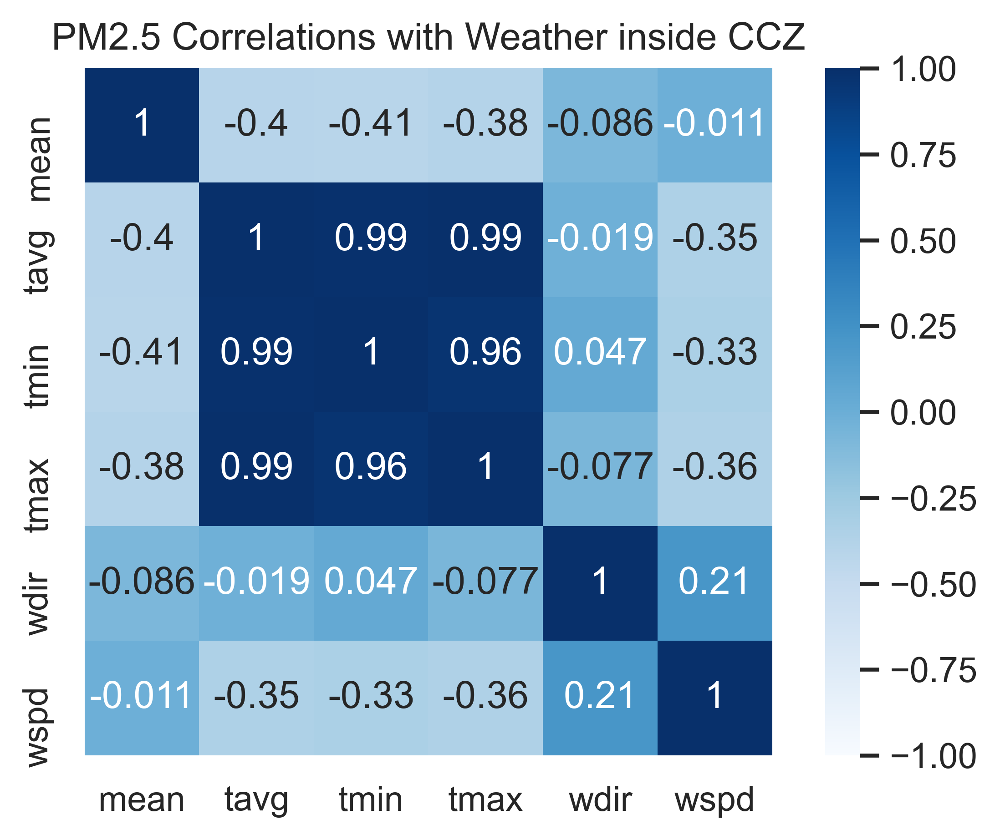

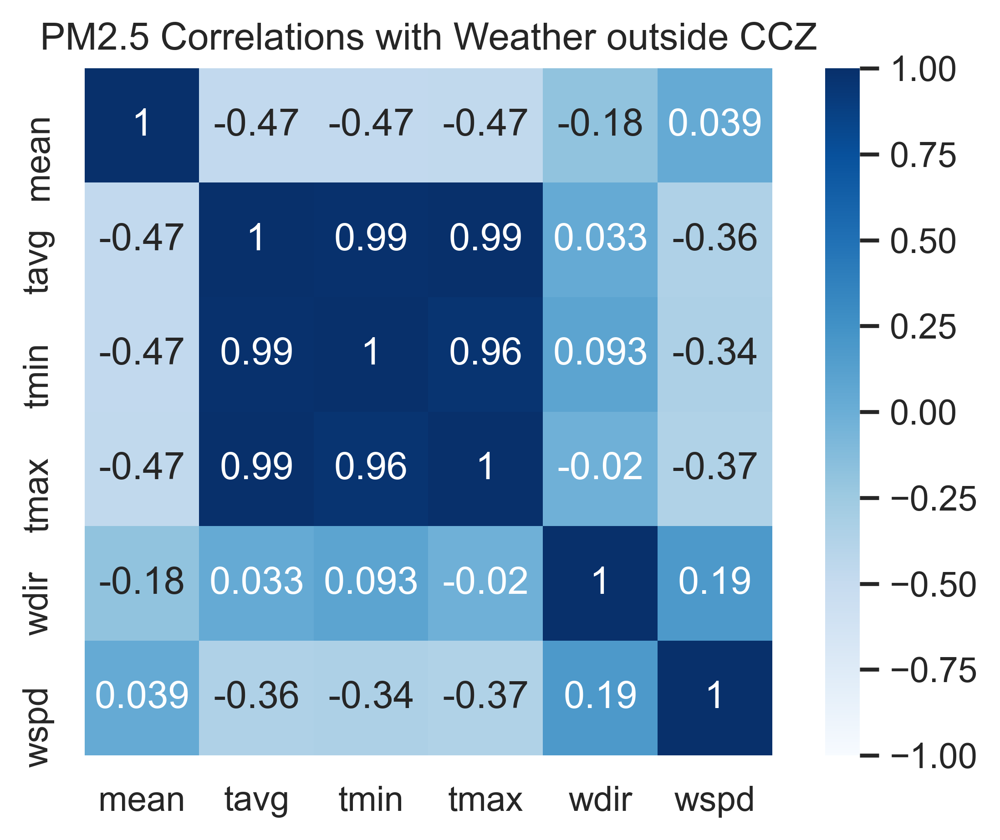

In [80]:
# Plot a heatmap to show the correlation of PM2.5 with weather variables

pm25_in_central = pm25_in_central.rename(columns = {'month_year':'time'})

# Merge the month_year column on time 
# Merge the PM2.5 Index within and out of Congestion Charge Zone on time

pm25_weather_in_central = pd.merge(pm25_in_central, congestion_zone_mean_Monthly, on = 'time', how = 'left')

# Rename the mean PM25 column as the PM25_mean_in_congestion for clarity

pm25_weather_in_central.rename(columns = {'mean':'pm25_mean_in_congestion'})

# Drop unused columns for correlation - 'time','year','month','std' 

pm25_weather_in_central = pm25_weather_in_central.drop(columns = ['time','year','month','std'])

# Calculate the correlation of the all parameters in pm25_weather_in_central dataframe

corr_pm25_weather_in_central = pm25_weather_in_central.corr(method ='pearson')




# Plot the same heat map for PM25 correlations with weather outside Congestion Charge Zone

pm25_not_in_central = pm25_not_in_central.rename(columns = {'month_year':'time'})

pm25_weather_not_in_central = pd.merge(pm25_not_in_central, congestion_zone_mean_Monthly, on = 'time', how = 'left')

pm25_weather_not_in_central.rename(columns = {'mean':'pm25_mean_is_not_in_congestion'})

pm25_weather_not_in_central = pm25_weather_not_in_central.drop(columns = ['time','year','month','std'])

corr_pm25_weather_not_in_central = pm25_weather_not_in_central.corr(method ='pearson')

plt.figure(figsize=(15, 5))
# Draw the heatmap to indicate correlations
plt.subplot(1, 2, 1)
sns.heatmap(corr_pm25_weather_in_central, annot = True, vmax = 1,vmin = -1, square = True, cmap = "Blues")
# Create Title for plot
plt.title('PM2.5 Correlations with Weather inside CCZ')

plt.subplot(1, 2, 2)
sns.heatmap(corr_pm25_weather_not_in_central, annot = True, vmax = 1,vmin = -1, square = True, cmap = "Blues")
plt.title('PM2.5 Correlations with Weather outside CCZ')
plt.show()

We plotted the correlation coefficient between PM25 emissions and weather factors in the congestion charge zone. The correlation coefficient between additional PM25 emissions in the region and weather factors outside the region was also plotted. We found that temperature is negatively correlated with PM2.5 emissions, which has a certain explanatory force. This could explain why PM2.5 emissions were lower in July and August because high temperatures discouraged people from driving in the summer months. In addition, there is no need to burn coal for heating in summer, which reduces PM2.5 emissions. However, during the cold winter months of December and January, PM2.5 emissions were not as high as in February and March. That may be because people drive more in February and March, but it doesn't explain why winter heating didn't push up PM2.5 levels in December and January.

Next we examined NOx emissions and its correlation with our chosen weather parameters.

### **(2) Analysis of NOx with Respect to Weather**

In [30]:
# Select the NOx data in Congestion Charge Zone and out of Congestion Charge Zone

# Selecting the NOx Index in Congestion Charge Zone from pollution dataframe 
# 'In_Central','parameter','unit' columns are not used so are dropped

nox_in_central = params_central.loc[(params_central['parameter'] == 'nox') & (params_central['In_Central'] == True)].drop(columns = ['In_Central','parameter','unit'])

# Select the NOx Index out of Congestion Charge Zone from pollution dataframe
# 'In_Central','parameter','unit' columns are not used so are dropped

nox_not_in_central = params_central.loc[(params_central['parameter'] == 'nox') & (params_central['In_Central'] == False)].drop(columns = ['In_Central','parameter','unit'])

# Merge NOx data in and out of Congestion Charge Zone on the date the data was recorded

nox = pd.merge(nox_in_central, nox_not_in_central, on = 'month_year', how = 'left')

# Rename the columns in NOx for clarity

nox.columns = ['nox_in_central','nox_in_central_std','nox_not_in_central','nox_not_in_central_std']

**The following plots show NOx leveels from January 2018 to December 2021 by month**

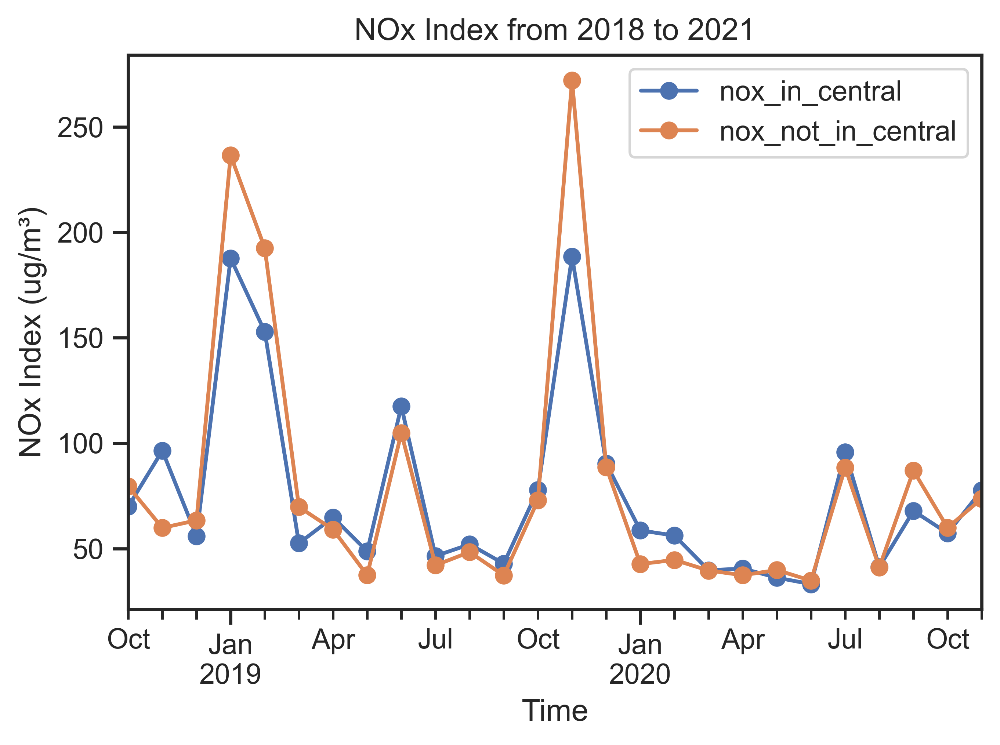

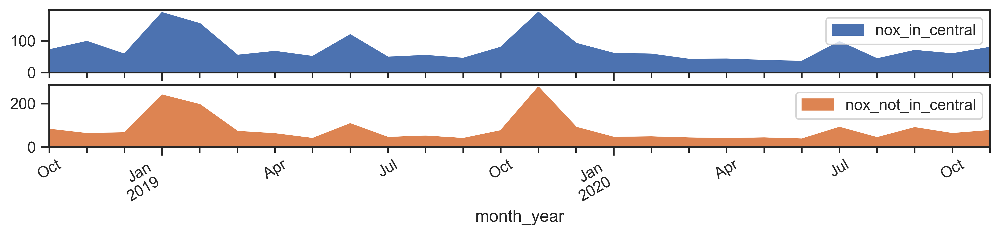

In [33]:
# Plot Nox data from Janurary 2018 to December 2021
# X-axis is the month/time of each recording, Y-axis is the value of NOx 

nox.plot(y = ['nox_in_central', 'nox_not_in_central'], marker='o')

# Define the x-axis - time
plt.xlabel('Time')

# Define the y-axis - NOx Index
plt.ylabel('NOx Index (ug/m\u00b3)')

# Define the title of the plot as NOx Index from Janurary 2018 to December 2021
plt.title('NOx Index from 2018 to 2021')
plt.show()

# Plot separate subplots 

axs = nox.plot.area(figsize = (12, 2),y = ['nox_in_central', 'nox_not_in_central'], subplots = True)
# Define the x-axis - time
plt.xlabel('Time')

# Define the y-axis - NOx Index
plt.ylabel('NOx Index (ug/m\u00b3)')

# Define the title of the plot as NOx Index from Janurary 2018 to December 2021
plt.title('The overview of NOx Index from 2018 to 2021')

**The following plot explores NOx standard deviation over time to assess the variability in NOx levels over time**

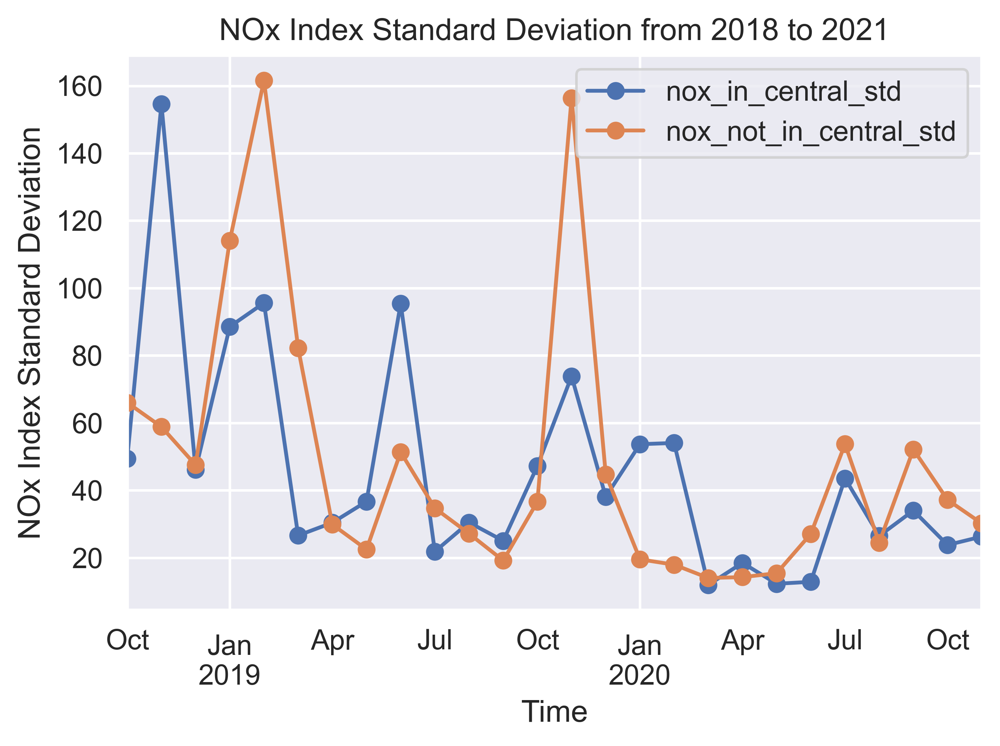

In [89]:
# Plot Nox Index Standard Deviation from Janurary 2018 to December 2021 

nox.plot(y = ['nox_in_central_std', 'nox_not_in_central_std'], marker = 'o')
plt.xlabel('Time')
plt.ylabel('NOx Index Standard Deviation')
plt.title('NOx Index Standard Deviation from 2018 to 2021')
plt.show()

According to the first two charts, we find that the peak of NOx emissions outside the Congestion Charge Zone are greater than within the Congestion Charge Zone. Overall, NOx emissions within the region are less than those outside the region. Based on the standard deviation, from 2020, the volatility of NOx emissions showed an overall downward trend, suggesting that the charge policy reduces NOx emissions in the congestion charge zone. This could also be due to a reduction in vehicle use caused by the Covid-19 pandemic. However, NOx emissions outside the Congestion Charge Zone fluctuate greatly, which reflects that NOx emissions are not regulated by policies. When residential or industrial activities increase, it could be possible that NOx emissions rise in tandem.

**The next two cells set up the NOx data to visualize average data per year and per month in a box plot**

In [34]:
# The date time column in nox_in_central dataframe is the index and it extracts the year and month value of the 
# index directly.

nox_in_central = nox_in_central.reset_index()

# Reset the index of the dataframe getting the year and month value of the date time
# Amend month_year to datetime data type

nox_in_central['month_year'] = pd.to_datetime(nox_in_central['month_year'])

# Extract the year from the month_year column and define a new column to record year 

nox_in_central['year'] = nox_in_central['month_year'].dt.year

# Extract the month from the month_year column and define a new column to record month

nox_in_central['month'] = nox_in_central['month_year'].dt.month

# Perform same process for nox_not_in_central 

nox_not_in_central = nox_not_in_central.reset_index()
nox_not_in_central['month_year'] = pd.to_datetime(nox_not_in_central['month_year'])
nox_not_in_central['year'] = nox_not_in_central['month_year'].dt.year
nox_not_in_central['month'] = nox_not_in_central['month_year'].dt.month

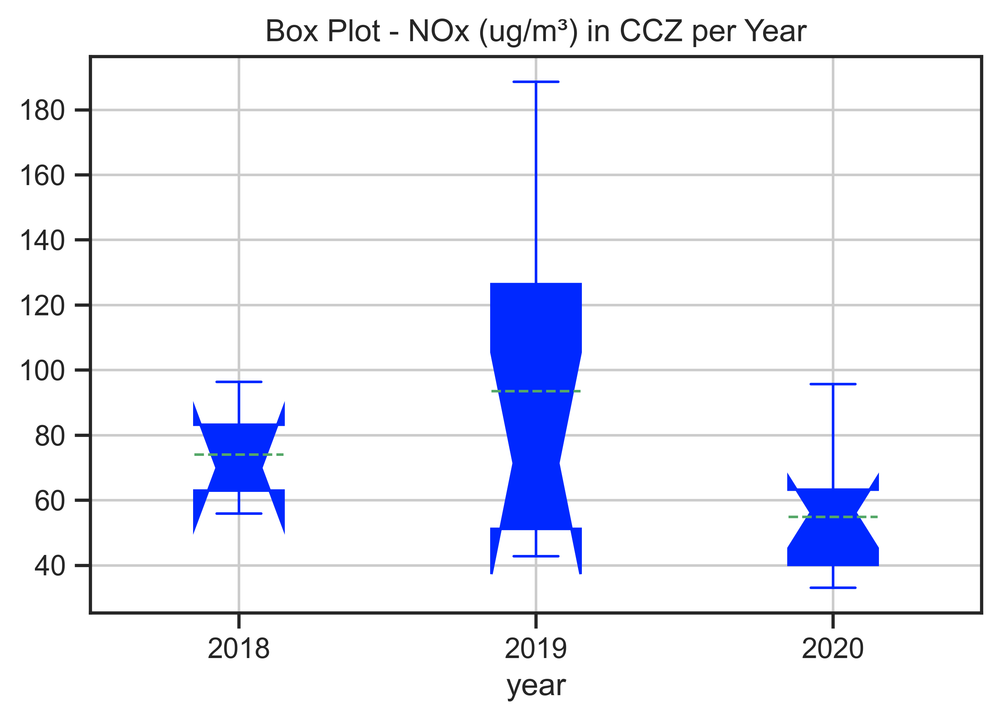

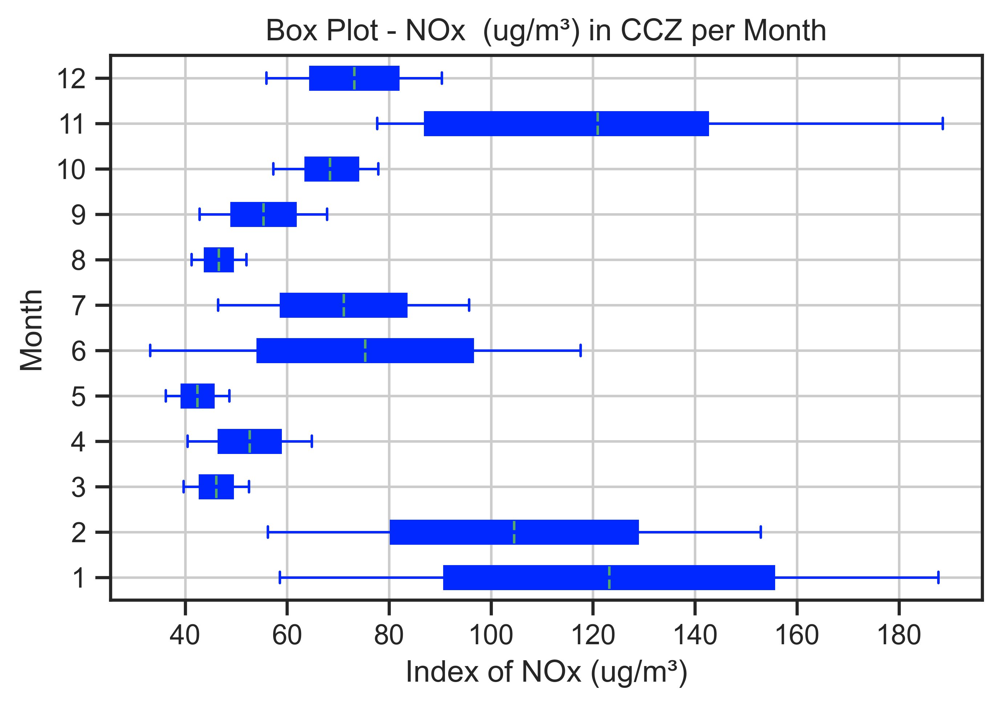

In [40]:
# Plot box plots to visualise the distribution of the NOx Index 
# The data will be grouped by the year column in both NOx dataframes
# The median value is denoted by the notch of the boxplot and the mean value is displayed as the dotted line

# Plotting NOx within Congestion Charge Zone - Yearly Data

nox_in_central.boxplot(by = 'year', column = ['mean'], patch_artist = True, meanline = True, showmeans = True, showfliers = True, notch = True,color='#0028FF')

# Create Box Plot Title

plt.title('Box Plot - NOx (ug/m\u00b3) in CCZ per Year',loc = 'center')

#remove the subtitle boxplot group by
plt.suptitle('')
plt.show()

# Plotting within Congestion Charge Zone - Monthly Data

nox_in_central.boxplot(by = 'month', column = ['mean'], patch_artist = True, meanline = True, showmeans = True, showfliers = True, notch = False, vert=False,color='#0028FF')

# Create Box Plot Title

plt.title('Box Plot - NOx  (ug/m\u00b3) in CCZ per Month')
plt.suptitle('')
plt.xlabel('Index of NOx (ug/m\u00b3)',loc = 'center')
plt.ylabel('Month',loc = 'center')
plt.show()

Based on the boxplot of annual NOx emissions in the Congestion Charge Zone, emissions were lowest in 2020, which could suggest that the Charging policy is effective to a certain extent and controls NOx emissions. Alternatively it could be due to the reduction in vehicle emissions due to the Covid-19 pandemic whereby there was a notable reduction in vehicle usage due to lockdowns.

The months with lowest NOx emissions are March, May and August. Emissions are high in January, February and November. High NOx emissions in January and February may be due to winter heating.

**Next we set up the data to assess the correlation between NOx emissions and weather both within and outside the CCZ**

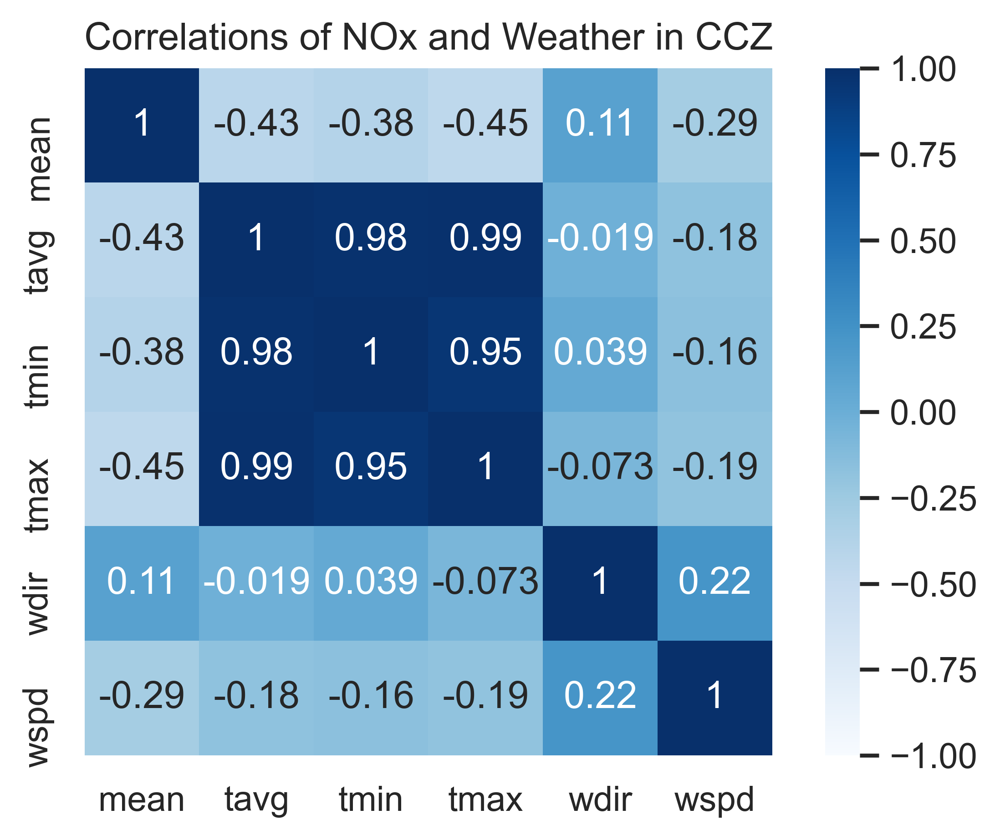

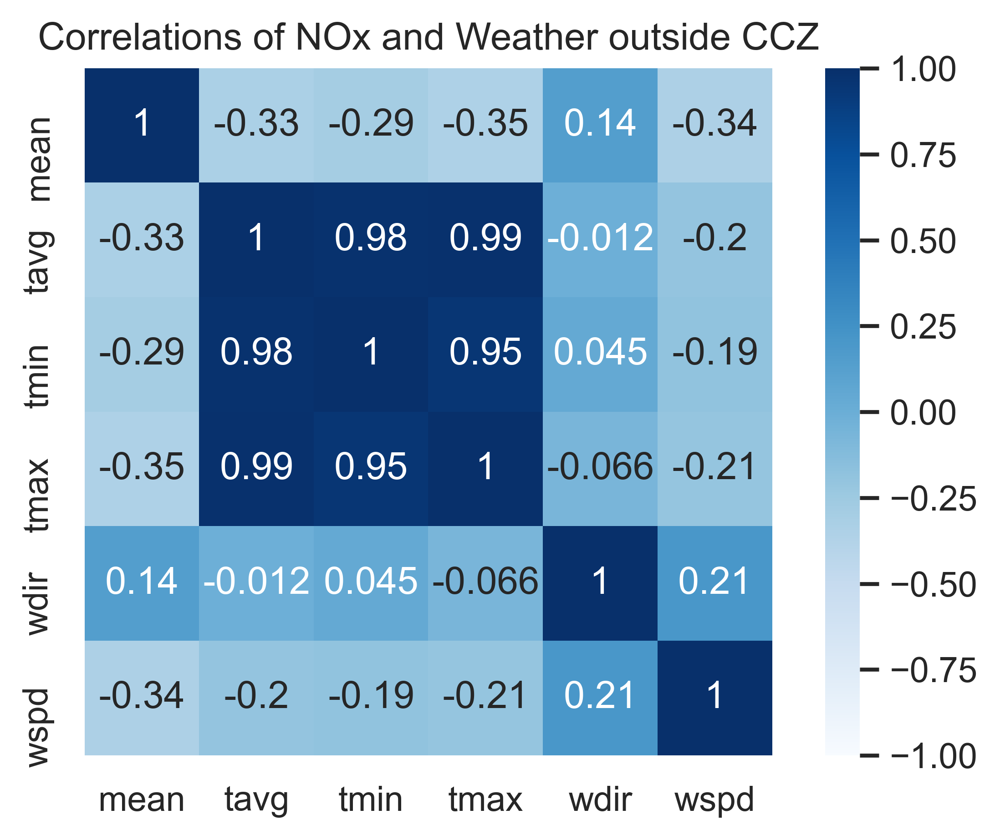

In [95]:
# Plot heatmap to show the correlation of NOx with weather parameters in CCZ
# Rename the month_year column to time for clarity

nox_in_central = nox_in_central.rename(columns = {'month_year':'time'})

# Merge the NOx Index in and out of the CCZ on time

nox_weather_in_central = pd.merge(nox_in_central, congestion_zone_mean_Monthly, on = 'time', how = 'left')

# Rename nox_mean_in_congestion to mean for clarity

nox_weather_in_central.rename(columns={'mean':'nox_mean_in_congestion'})

# Drop unused parameters 'time','year','month','std','wdir' for calculating correlation

nox_weather_in_central = nox_weather_in_central.drop(columns = ['time','year','month','std'])

# Calculate the correlation of all parameters in nox_weather_in_central dataframe

corr_nox_weather_in_central = nox_weather_in_central.corr(method ='pearson')



# Plot the heatmap to show the correlation of NOx with weather parameters outside CCZ

nox_not_in_central = nox_not_in_central.rename(columns = {'month_year':'time'})

nox_weather_not_in_central = pd.merge(nox_not_in_central, congestion_zone_mean_Monthly, on='time', how = 'left')

nox_weather_not_in_central.rename(columns = {'mean':'nox_mean_is_not_in_congestion'})

nox_weather_not_in_central = nox_weather_not_in_central.drop(columns = ['time','year','month','std'])

corr_nox_weather_not_in_central = nox_weather_not_in_central.corr(method = 'pearson')

plt.figure(figsize=(15, 5))

plt.subplot(1,2,1)

# Plot the heatmap to indicate the correlations of each parameter
sns.heatmap(corr_nox_weather_in_central, annot = True, vmax = 1, vmin = -1, square = True, cmap = "Blues")

# Create Title for Plot

plt.title('Correlations of NOx and Weather in CCZ')

plt.subplot(1,2,2)

sns.heatmap(corr_nox_weather_not_in_central, annot = True, vmax = 1,vmin = -1, square = True, cmap = "Blues")

plt.title('Correlations of NOx and Weather outside CCZ')
plt.show()


Finally, we found that there was a negative correlation between temperature and NOx emissions, and there was a negative correlation between wind speed and NOx emissions. Therefore, in March, May and August, there may be a reduction in NOx emissions due to higher temperatures, but this does not explain why there are still higher emissions in June and July. In addition, the wind speed outside the region has a stronger negative correlation with NOx emissions than within the region, probably because there has fewer buildings outside the congestion charge zone and better air circulation. Therefore, when the wind speed is slightly higher, more NOx can be dispersed, the concentration of NOx is reduced, and the detected emissions are smaller.

### **Conclusion**

In the beginning of this report, we employed a regression model of the pollution index with each weather condition parameter and whether in the congestion zone has been done. Although inside or outside the congestion charging zone is treated as a variable in the regression model, the details of pollution data inside and outside the congestion charging zone are revealed in further study. The behaviour and distribution of pm2.5 and NOx with weather data over a specific period are analyzed and visualized. Several types of plots are applied.

The moving trend of the PM2.5 in the central zone will be constantly higher than the PM 2.5 outside the congestion charging zone. However, the PM2.5 outside the congestion charging zone was higher than inside the PM2.5 index sometimes after July 2019. It seems that the effectiveness of the policy became better after that time. Back to the overall trend of the inside and outside PM2.5 index movement, the homogeneous shape is displayed. Nevertheless, the NOx outside congestion charging index is slightly higher than NOx data outside the congestion charging zone with the same movement pattern.

For the distribution of the PM2.5 and NOx, the distribution of both pollution data shrunk dramatically from 2019 to 2020, it may be induced by the COVID-19, and the traffic number decreased. It is remarkable that each pollution data's distribution and mean value dropped from January and rebounded in June every year. The pollution indexes are more easily affected by the temperature and the wind speed. Whether inside congestion charging or not, the temperature has the tightest negative relationship with the pollution index among all weather condition parameters due to the slightest negative correlation value.
